PyFAI and easyXRD Use

## Imports

In [3]:
%matplotlib widget

In [5]:
#General Libraries
import os
import time
import glob
import copy
import tomopy
import pybaselines
import numpy as np
import pandas as pd
import xarray as xr
import PIL
from PIL import Image
import fabio
from scipy.ndimage import median_filter
#Matplotlib
import matplotlib.pyplot as plt
plt.rcParams["figure.constrained_layout.use"] = True
import matplotlib.gridspec as gridspec
from matplotlib.pyplot import subplots
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)
#pyFAI
import pyFAI
from pyFAI.gui import jupyter
import fabio
from pyFAI.test.utilstest import UtilsTest
from pyFAI.calibrant import CALIBRANT_FACTORY
from pyFAI.goniometer import SingleGeometry
from pyFAI.gui.jupyter.calib import Calibration
print(f'Using pyFAI version: {pyFAI.version}')
#diffpy ###USE IN venv CMI-37###
#import diffpy
#import diffpy.pdfgetx
#from diffpy.pdfgetx import PDFGetter, PDFConfig, loadData, Transformation

/opt/anaconda3/lib/python3.12/site-packages/pytools/persistent_dict.py:52: RecommendedHashNotFoundWarning: Unable to import recommended hash 'siphash24.siphash13', falling back to 'hashlib.sha256'. Run 'python3 -m pip install siphash24' to install the recommended hash.
  warn("Unable to import recommended hash 'siphash24.siphash13', "


Using pyFAI version: 2024.9.0


In [7]:
import sys
sys.path += ["/Users/danielonolan/easyXRD"] 
from easyxrd.core import exrd #Mehmet's Package (remind him to put in a setup.py)



Checking required packages:

---xarray package with version 2023.6.0 is available and can be imported 
---pybaselines package with version 1.1.0 is available and can be imported 
---pyFAI package with version 2024.9.0 is available and can be imported 
---numpy package with version 1.26.4 is available and can be imported 
---ipympl package with version 0.9.4 is available and can be imported 
---scipy package with version 1.13.1 is available and can be imported 
---pymatgen package with version 2024.11.13 is available and can be imported 
---mp_api package with version 0.43.0 is available and can be imported 
---fabio package with version 2024.9.0 is available and can be imported 
---pandas package with version 2.2.2 is available and can be imported 


Imported easyxrd with the following configuration:

easyxrd_scratch_path : /Users/danielonolan/.easyxrd_scratch
gsasii_lib_path : /Users/danielonolan/g2full/GSAS-II/GSASII
mp_api_key : none......


## File Paths

In [9]:
path_to_calibs = '/Volumes/ONolan 2TB/2024-3-XPD-data/_calibrations/'

In [11]:
path_to_nc = '/Volumes/ONolan 2TB/2024-3-XPD-data/08-exsitu-samples/data/'

In [13]:
path_to_out = '/Volumes/ONolan 2TB/2024-3-XPD-data/08-exsitu-samples/out_files/'

## Data File Lists

In [15]:
nc_files = [os.path.basename(x) for x in sorted(glob.glob(path_to_nc+"*.nc"))]
nc_files

['20241121-122449_step_scan_uid=4597a3ac__.nc',
 '20241121-123005_step_scan_uid=a1b309d5__.nc',
 '20241121-124310_step_scan_uid=52d45825__set1.nc',
 '20241121-130732_step_scan_uid=de385fb5__set1_PDF.nc',
 '20241121-132612_step_scan_uid=58f1c735__set2_XRD.nc',
 '20241121-134623_step_scan_uid=7a6bafaa__set2_PDF.nc']

**Set 1, PXRD and PDF**

In [18]:
with xr.open_dataset(path_to_nc+'20241121-124310_step_scan_uid=52d45825__set1.nc') as ds_set1_xrd:
    ds_set1_xrd.load()
ds_set1_xrd

<xarray.Dataset>
Dimensions:       (pe1_y: 2048, pe1_x: 2048, mBaseX: 501)
Coordinates:
  * pe1_y         (pe1_y) int64 0 1 2 3 4 5 6 ... 2042 2043 2044 2045 2046 2047
  * pe1_x         (pe1_x) int64 0 1 2 3 4 5 6 ... 2042 2043 2044 2045 2046 2047
  * mBaseX        (mBaseX) float64 -10.0 -9.96 -9.919 ... 10.12 10.16 10.2
Data variables:
    pe1_img_dark  (pe1_y, pe1_x) uint16 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0
    pe1_imgs      (mBaseX, pe1_y, pe1_x) uint16 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0
    pe1_stats1    (mBaseX) float32 2.038e+10 2.038e+10 ... 2.049e+10 2.049e+10
Attributes: (12/59)
    user_note:               set1
    type:                    step_scan
    save_to:                 data
    save_name:               _set1
    take_dark:               true
    uid_dark:                19361a73-1b4c-4939-96fc-a6dbc92a4b0f
    ...                      ...
    pe1_exposure:            1.0
    pe1_num_exposures:       1
    pe1_acq_time_dark:       0.1
    pe1_exposure_dark:       1.0
    pe1_num_exposures_dark:  1
    uid:                     52d45825-f274-4f06-af1e-81fe99e683e9

In [22]:
with xr.open_dataset(path_to_nc+'20241121-130732_step_scan_uid=de385fb5__set1_PDF.nc') as ds_set1_pdf:
    ds_set1_pdf.load()
ds_set1_pdf

<xarray.Dataset>
Dimensions:       (pe1_y: 2048, pe1_x: 2048, mBaseX: 375)
Coordinates:
  * pe1_y         (pe1_y) int64 0 1 2 3 4 5 6 ... 2042 2043 2044 2045 2046 2047
  * pe1_x         (pe1_x) int64 0 1 2 3 4 5 6 ... 2042 2043 2044 2045 2046 2047
  * mBaseX        (mBaseX) float64 -8.8 -8.75 -8.7 -8.65 ... 9.75 9.8 9.85 9.9
Data variables:
    pe1_img_dark  (pe1_y, pe1_x) uint16 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0
    pe1_imgs      (mBaseX, pe1_y, pe1_x) uint16 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0
    pe1_stats1    (mBaseX) float32 2.115e+10 2.115e+10 ... 2.109e+10 2.111e+10
Attributes: (12/59)
    user_note:               set1_PDF
    type:                    step_scan
    save_to:                 data
    save_name:               _set1_PDF
    take_dark:               true
    uid_dark:                dee1d00e-0d7b-416a-9bc0-6d1d37fac692
    ...                      ...
    pe1_exposure:            1.0
    pe1_num_exposures:       1
    pe1_acq_time_dark:       0.1
    pe1_exposure_dark:       1.0
    pe1_num_exposures_dark:  1
    uid:                     de385fb5-8016-4acb-8650-231d5b3feade

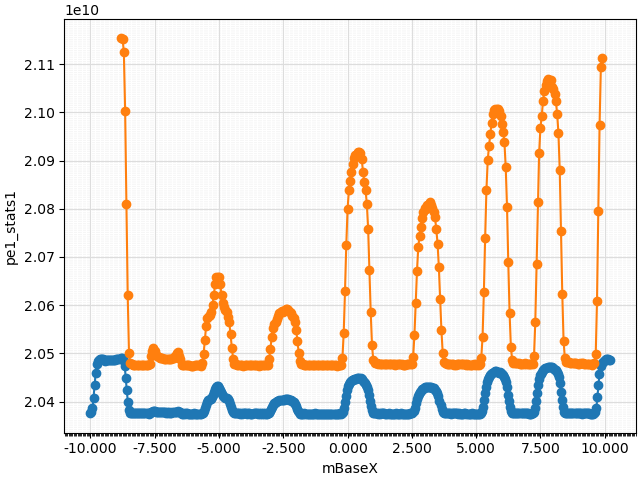

In [24]:
fig = plt.figure()
ax = fig.add_subplot(1,1,1)

ds_set1_xrd.pe1_stats1.plot(ax=ax,marker='o')
ds_set1_pdf.pe1_stats1.plot(ax=ax,marker='o')

ax.xaxis.set_major_formatter('{x:.3f}')
ax.xaxis.set_minor_locator(MultipleLocator(0.05))
ax.grid(which='major', color='#DDDDDD', linewidth=0.8)
ax.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)

In [28]:
set1_mBaseX_dict = {'Set 1': ['CeO2','Kapton','ZnO2','ZnO2-PO4','LaCO3','LaCO3-PO4','CeCO3','CeCO3-PO4','CeO2'],
                    'mBaseX / min' : [-9.640,-7.560,-5.520,-2.950,-0.085,2.640,5.350,7.330,9.780],
                    'mBaseX / max' : [-8.675,-6.570,-4.500,-1.990,0.850,3.600,6.265,8.330,10.200]
                    }
df_set1_mBaseX = pd.DataFrame(set1_mBaseX_dict)
df_set1_mBaseX

,Set 1,mBaseX / min,mBaseX / max
0,CeO2,-9.640,-8.675
1,Kapton,-7.560,-6.570
2,ZnO2,-5.520,-4.500
3,ZnO2-PO4,-2.950,-1.990
4,LaCO3,-0.085,0.850
5,LaCO3-PO4,2.640,3.600
6,CeCO3,5.350,6.265
7,CeCO3-PO4,7.330,8.330
8,CeO2,9.780,10.200


**Set 2, PXRD and PDF**

In [56]:
with xr.open_dataset(path_to_nc+'20241121-132612_step_scan_uid=58f1c735__set2_XRD.nc') as ds_set2_xrd:
    ds_set2_xrd.load()
ds_set2_xrd

<xarray.Dataset>
Dimensions:       (pe1_y: 2048, pe1_x: 2048, mBaseX: 375)
Coordinates:
  * pe1_y         (pe1_y) int64 0 1 2 3 4 5 6 ... 2042 2043 2044 2045 2046 2047
  * pe1_x         (pe1_x) int64 0 1 2 3 4 5 6 ... 2042 2043 2044 2045 2046 2047
  * mBaseX        (mBaseX) float64 -8.8 -8.75 -8.7 -8.65 ... 9.75 9.8 9.85 9.9
Data variables:
    pe1_img_dark  (pe1_y, pe1_x) uint16 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0
    pe1_imgs      (mBaseX, pe1_y, pe1_x) uint16 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0
    pe1_stats1    (mBaseX) float32 2.048e+10 2.045e+10 ... 2.044e+10 2.047e+10
Attributes: (12/59)
    user_note:               _set2_XRD
    type:                    step_scan
    save_to:                 data
    save_name:               _set2_XRD
    take_dark:               true
    uid_dark:                d5d91982-e51b-46bf-9079-781fedc75b5d
    ...                      ...
    pe1_exposure:            1.0
    pe1_num_exposures:       1
    pe1_acq_time_dark:       0.1
    pe1_exposure_dark:       1.0
    pe1_num_exposures_dark:  1
    uid:                     58f1c735-0fec-41fc-a65d-d082d655714d

In [58]:
with xr.open_dataset(path_to_nc+'20241121-134623_step_scan_uid=7a6bafaa__set2_PDF.nc') as ds_set2_pdf:
    ds_set2_pdf.load()
ds_set2_pdf

<xarray.Dataset>
Dimensions:       (pe1_y: 2048, pe1_x: 2048, mBaseX: 375)
Coordinates:
  * pe1_y         (pe1_y) int64 0 1 2 3 4 5 6 ... 2042 2043 2044 2045 2046 2047
  * pe1_x         (pe1_x) int64 0 1 2 3 4 5 6 ... 2042 2043 2044 2045 2046 2047
  * mBaseX        (mBaseX) float64 -8.8 -8.75 -8.7 -8.65 ... 9.75 9.8 9.85 9.9
Data variables:
    pe1_img_dark  (pe1_y, pe1_x) uint16 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0
    pe1_imgs      (mBaseX, pe1_y, pe1_x) uint16 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0
    pe1_stats1    (mBaseX) float32 2.11e+10 2.096e+10 ... 2.092e+10 2.109e+10
Attributes: (12/59)
    user_note:               _set2_PDF
    type:                    step_scan
    save_to:                 data
    save_name:               _set2_PDF
    take_dark:               true
    uid_dark:                6b9bd58f-422d-4c10-988f-253104b20052
    ...                      ...
    pe1_exposure:            1.0
    pe1_num_exposures:       1
    pe1_acq_time_dark:       0.1
    pe1_exposure_dark:       1.0
    pe1_num_exposures_dark:  1
    uid:                     7a6bafaa-993f-4cee-97e9-9c98976a6f3b

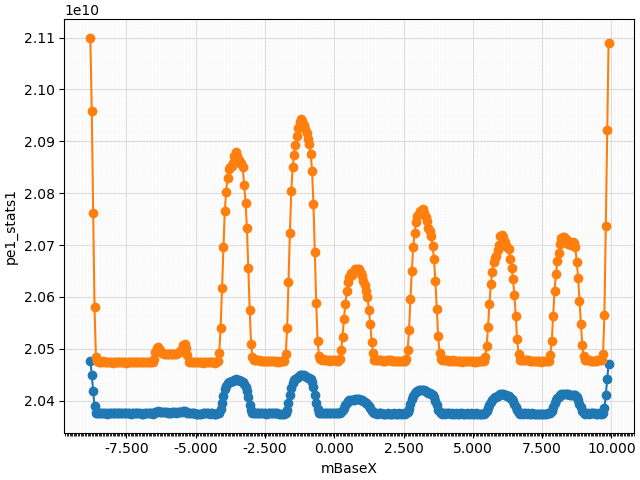

In [36]:
fig = plt.figure()
ax = fig.add_subplot(1,1,1)

ds_set2_xrd.pe1_stats1.plot(ax=ax,marker='o')
ds_set2_pdf.pe1_stats1.plot(ax=ax,marker='o')

ax.xaxis.set_major_formatter('{x:.3f}')
ax.xaxis.set_minor_locator(MultipleLocator(0.05))
ax.grid(which='major', color='#DDDDDD', linewidth=0.8)
ax.grid(which='minor', color='#EEEEEE', linestyle=':', linewidth=0.5)

In [18]:
set2_mBaseX_dict = {'Set 2': ['CeO2','Kapton','Eutrosorb','Eutrosorb-PO4','B1-58','B1-58-PO4','B1-60','B1-60-PO4','CeO2'],
                    'mBaseX / min' : [-9.640,-6.350,-4.065,-1.650,0.330,2.741,5.576,7.882,9.780],
                    'mBaseX / max' : [-8.675,-5.385,-3.074,-0.680,1.325,3.717,6.570,8.878,9.900]
                    }
df_set2_mBaseX = pd.DataFrame(set2_mBaseX_dict)
df_set2_mBaseX

,Set 2,mBaseX / min,mBaseX / max
0,CeO2,-9.640,-8.675
1,Kapton,-6.350,-5.385
2,Eutrosorb,-4.065,-3.074
3,Eutrosorb-PO4,-1.650,-0.680
4,B1-58,0.330,1.325
5,B1-58-PO4,2.741,3.717
6,B1-60,5.576,6.570
7,B1-60-PO4,7.882,8.878
8,CeO2,9.780,9.900


## Calibrations

**Calibration standards collected on LaB6**

poni and edf files prepared using a standard LaB6 sample at XRD and PDF sample-to-detector distances.

In [42]:
ai_XRD = pyFAI.load(path_to_calibs+'calibration_XRD.poni')
mask_XRD = fabio.open(path_to_calibs+'mask_XRD.edf').data

ai_PDF = pyFAI.load(path_to_calibs+'calibration_PDF.poni')
mask_PDF = fabio.open(path_to_calibs+'mask_PDF.edf').data

In [44]:
ai_XRD

Detector Perkin detector%s	 PixelSize= 200µm, 200µm
Wavelength= 1.806000e-11 m
SampleDetDist= 9.964069e-01 m	PONI= 2.165419e-01, 2.040557e-01 m	rot1=-0.000186  rot2=-0.007323  rot3=0.000000 rad
DirectBeamDist= 996.434 mm	Center: x=1021.205, y=1046.224 pix	Tilt= 0.420° tiltPlanRotation= -88.546° 𝛌= 0.181Å

In [46]:
ai_PDF

Detector Perkin detector%s	 PixelSize= 200µm, 200µm
Wavelength= 1.806000e-11 m
SampleDetDist= 2.233564e-01 m	PONI= 2.122500e-01, 2.056160e-01 m	rot1=-0.001180  rot2=-0.001396  rot3=0.000000 rad
DirectBeamDist= 223.357 mm	Center: x=1029.397, y=1059.691 pix	Tilt= 0.105° tiltPlanRotation= -49.801° 𝛌= 0.181Å

==========================================

**Verification of calibration standards**

CeO2 samples are collected at either end of the sample holder to verify that the sample holder is perpendicular to the beam.

**SET 1**

XRD

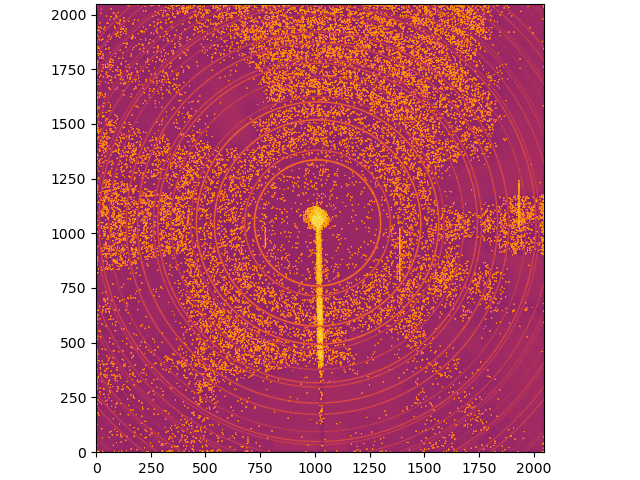

In [61]:
ds_set1_xrd_CeO2_left = ds_set1_xrd["pe1_imgs"].data[16,:,:]- ds_set1_xrd["pe1_img_dark"].data 
ax = jupyter.display(ds_set1_xrd_CeO2_left)

In [25]:
wl = 0.1806e-10 # The wavelength is 1 Å
PE1 = pyFAI.detector_factory("PerkinElmer")
CeO2 = CALIBRANT_FACTORY('CeO2')
CeO2.wavelength = wl

In [ ]:
calibration_set1_xrd_CeO2_left = Calibration(ds_set1_xrd_CeO2_left,calibrant=CeO2,wavelength=wl,detector=PE1)

In [319]:
georef_set1_xrd_CeO2_left = calibration_set1_xrd_CeO2_left.geoRef
print(georef_set1_xrd_CeO2_left)
print(f"Fixed parameters: {calibration_set1_xrd_CeO2_left.fixed}")
print(f"Cost function: {georef_set1_xrd_CeO2_left.chi2()}")

Detector Perkin detector%s	 PixelSize= 200µm, 200µm
Wavelength= 1.806000e-11 m
SampleDetDist= 9.960516e-01 m	PONI= 2.147690e-01, 2.027730e-01 m	rot1=0.000208  rot2=-0.005354  rot3=0.000000 rad
DirectBeamDist= 996.066 mm	Center: x=1012.829, y=1047.180 pix	Tilt= 0.307° tiltPlanRotation= -92.224° 𝛌= 0.181Å
Fixed parameters: ['wavelength', 'rot3']
Cost function: 3.168450231515375e-07


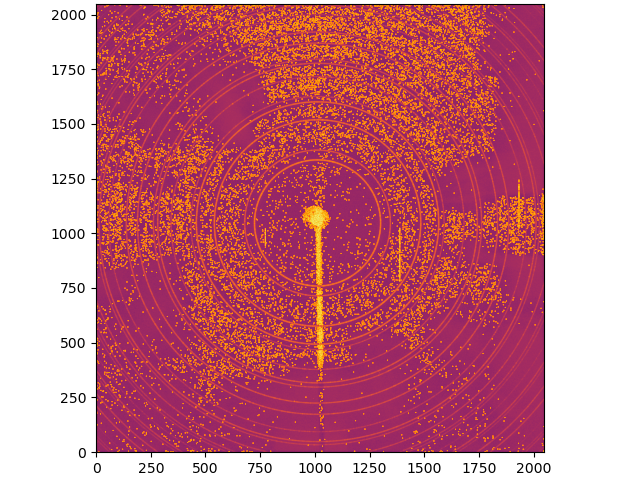

In [72]:
ds_set1_xrd_CeO2_right = ds_set1_xrd["pe1_imgs"].data[-1,:,:]- ds_set1_xrd["pe1_img_dark"].data 
ax = jupyter.display(ds_set1_xrd_CeO2_right)

In [324]:
calibration_set1_xrd_CeO2_right = Calibration(ds_set1_xrd_CeO2_right,calibrant=CeO2,wavelength=wl,detector=PE1)

In [326]:
georef_set1_xrd_CeO2_right = calibration_set1_xrd_CeO2_right.geoRef
print(georef_set1_xrd_CeO2_right)
print(f"Fixed parameters: {calibration_set1_xrd_CeO2_right.fixed}")
print(f"Cost function: {georef_set1_xrd_CeO2_right.chi2()}")

Detector Perkin detector%s	 PixelSize= 200µm, 200µm
Wavelength= 1.806000e-11 m
SampleDetDist= 9.961396e-01 m	PONI= 2.159444e-01, 2.033938e-01 m	rot1=0.000830  rot2=-0.006525  rot3=0.000000 rad
DirectBeamDist= 996.161 mm	Center: x=1012.835, y=1047.225 pix	Tilt= 0.377° tiltPlanRotation= -97.249° 𝛌= 0.181Å
Fixed parameters: ['wavelength', 'rot3']
Cost function: 2.819297569559789e-07


Left-side Direct Beam Distance = 996.066 mm, Right-side Direct Beam Distance = 996.161 mm; Average Direct Beam Distance = 996.114 mm

The sample holder was 0.095 mm out of square (0.01% variation), a shift of 10 um per sample

LaB6 Direct Beam Distance 'x' Center is off by 9 pixels -- **Not OK to use LaB6 poni for Set 1 PXRD**

In [370]:
georef_set1_xrd_CeO2_left.save(path_to_out+'Set1_XRD_CeO2_Left.poni')
ai_Set1_XRD = pyFAI.load(georef_set1_xrd_CeO2_left)

**SET 1**

PDF

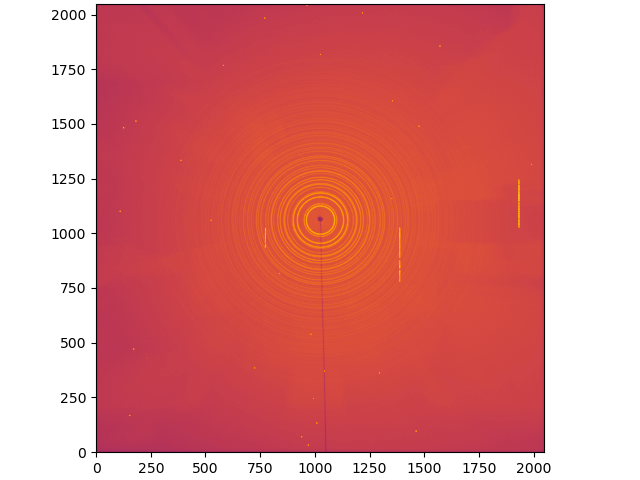

In [82]:
ds_set1_pdf_CeO2_left = ds_set1_pdf["pe1_imgs"].data[0,:,:]- ds_set1_pdf["pe1_img_dark"].data 
ax = jupyter.display(ds_set1_pdf_CeO2_left)

In [430]:
calibration_set1_pdf_CeO2_left = Calibration(ds_set1_pdf_CeO2_left,calibrant=CeO2,wavelength=wl,detector=PE1)

In [432]:
georef_set1_pdf_CeO2_left = calibration_set1_pdf_CeO2_left.geoRef
print(georef_set1_pdf_CeO2_left)
print(f"Fixed parameters: {calibration_set1_pdf_CeO2_left.fixed}")
print(f"Cost function: {georef_set1_pdf_CeO2_left.chi2()}")

Detector Perkin detector%s	 PixelSize= 200µm, 200µm
Wavelength= 1.806000e-11 m
SampleDetDist= 2.235122e-01 m	PONI= 2.124108e-01, 2.072071e-01 m	rot1=0.008713  rot2=-0.001809  rot3=0.000000 rad
DirectBeamDist= 223.521 mm	Center: x=1026.298, y=1060.032 pix	Tilt= 0.510° tiltPlanRotation= -168.271° 𝛌= 0.181Å
Fixed parameters: ['wavelength', 'rot3']
Cost function: 4.763295009955463e-05


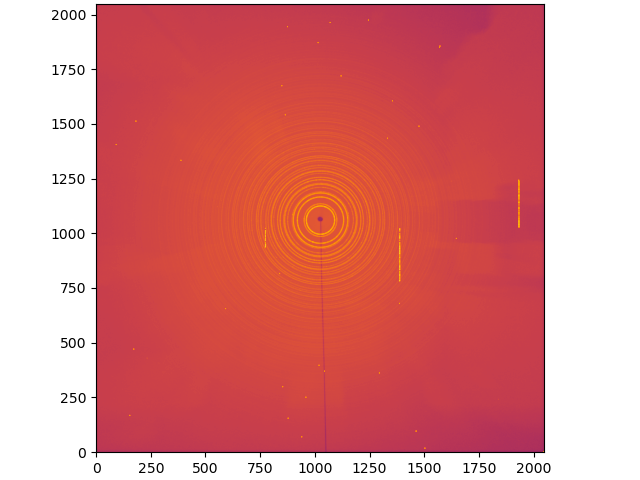

In [90]:
ds_set1_pdf_CeO2_right = ds_set1_pdf["pe1_imgs"].data[-1,:,:]- ds_set1_pdf["pe1_img_dark"].data 
ax = jupyter.display(ds_set1_pdf_CeO2_right)

In [434]:
calibration_set1_pdf_CeO2_right = Calibration(ds_set1_pdf_CeO2_right,calibrant=CeO2,wavelength=wl,detector=PE1)

In [436]:
georef_set1_pdf_CeO2_right = calibration_set1_pdf_CeO2_right.geoRef
print(georef_set1_pdf_CeO2_right)
print(f"Fixed parameters: {calibration_set1_pdf_CeO2_right.fixed}")
print(f"Cost function: {georef_set1_pdf_CeO2_right.chi2()}")

Detector Perkin detector%s	 PixelSize= 200µm, 200µm
Wavelength= 1.806000e-11 m
SampleDetDist= 2.235255e-01 m	PONI= 2.120582e-01, 2.057131e-01 m	rot1=0.001991  rot2=-0.000170  rot3=0.000000 rad
DirectBeamDist= 223.526 mm	Center: x=1026.341, y=1060.100 pix	Tilt= 0.114° tiltPlanRotation= -175.106° 𝛌= 0.181Å
Fixed parameters: ['wavelength', 'rot3']
Cost function: 5.3626749393293674e-05


Left-side Direct Beam Distance = 223.367 mm, Right-side Direct Beam Distance = 223.436 mm; Average Direct Beam Distance = 223.402 mm

The sample holder was 0.069 mm out of square (0.05% variation), a shift of 7.6 um per sample

LaB6 Direct Beam Distance = 223.357 mm (0.02% greater than CeO2 averagedd distance) -- **Not OK to use LaB6 poni/edf for Set 1 PDF**

In [439]:
georef_set1_pdf_CeO2_left.save(path_to_out+'Set1_PDF_CeO2_Left.poni')
ai_Set1_PDF = pyFAI.load(georef_set1_pdf_CeO2_left)

**SET 2**

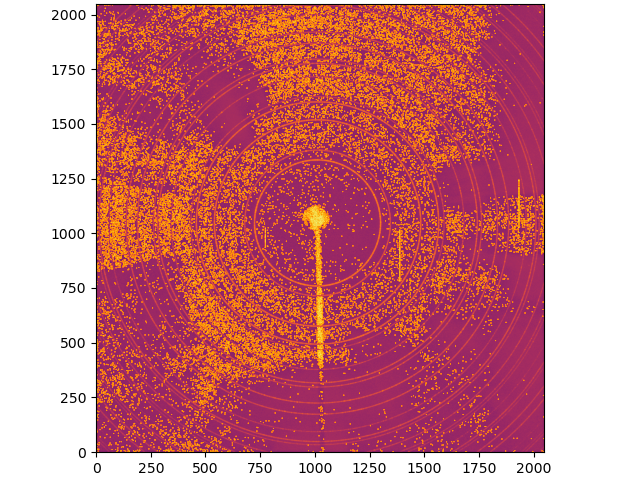

In [99]:
ds_set2_xrd_CeO2_left = ds_set2_xrd["pe1_imgs"].data[0,:,:]- ds_set2_xrd["pe1_img_dark"].data 
ax = jupyter.display(ds_set2_xrd_CeO2_left)

In [420]:
calibration_set2_xrd_CeO2_left = Calibration(ds_set2_xrd_CeO2_left,calibrant=CeO2,wavelength=wl,detector=PE1)

In [422]:
georef_set2_xrd_CeO2_left = calibration_set2_xrd_CeO2_left.geoRef
print(georef_set2_xrd_CeO2_left)
print(f"Fixed parameters: {calibration_set2_xrd_CeO2_left.fixed}")
print(f"Cost function: {georef_set2_xrd_CeO2_left.chi2()}")

Detector Perkin detector%s	 PixelSize= 200µm, 200µm
Wavelength= 1.806000e-11 m
SampleDetDist= 9.959007e-01 m	PONI= 2.161637e-01, 2.032296e-01 m	rot1=0.000661  rot2=-0.006737  rot3=0.000000 rad
DirectBeamDist= 995.923 mm	Center: x=1012.857, y=1047.271 pix	Tilt= 0.388° tiltPlanRotation= -95.602° 𝛌= 0.181Å
Fixed parameters: ['wavelength', 'rot3']
Cost function: 1.4794710801865282e-07


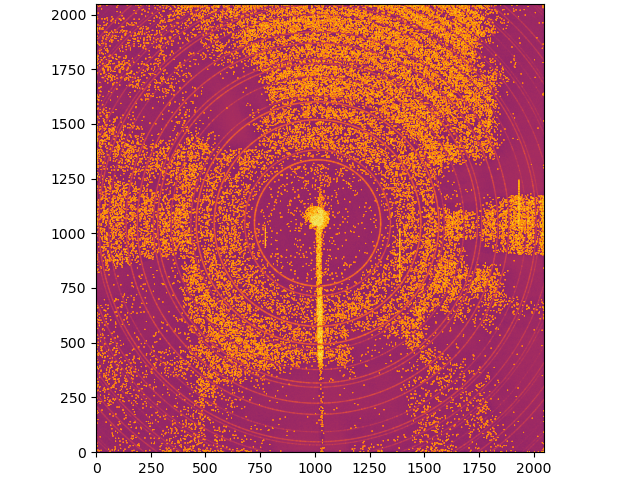

In [112]:
ds_set2_xrd_CeO2_right = ds_set2_xrd["pe1_imgs"].data[-1,:,:]- ds_set2_xrd["pe1_img_dark"].data 
ax = jupyter.display(ds_set2_xrd_CeO2_right)

In [489]:
calibration_set2_xrd_CeO2_right = Calibration(ds_set1_xrd_CeO2_right,calibrant=CeO2,wavelength=wl,detector=PE1)

In [491]:
georef_set2_xrd_CeO2_right = calibration_set2_xrd_CeO2_right.geoRef
print(georef_set2_xrd_CeO2_right)
print(f"Fixed parameters: {calibration_set2_xrd_CeO2_right.fixed}")
print(f"Cost function: {georef_set2_xrd_CeO2_right.chi2()}")

Detector Perkin detector%s	 PixelSize= 200µm, 200µm
Wavelength= 1.806000e-11 m
SampleDetDist= 9.961562e-01 m	PONI= 2.157123e-01, 2.021719e-01 m	rot1=-0.000387  rot2=-0.006298  rot3=0.000000 rad
DirectBeamDist= 996.176 mm	Center: x=1012.787, y=1047.190 pix	Tilt= 0.362° tiltPlanRotation= -86.483° 𝛌= 0.181Å
Fixed parameters: ['wavelength', 'rot3']
Cost function: 7.999538147513517e-07


###### Left-side Direct Beam Distance = 995.901 mm, Right-side Direct Beam Distance = 996.156 mm; Average Direct Beam Distance = 996.029 mm

The sample holder was 0.255 mm out of square (0.03% variation), a shift of 28 um per sample

**OK to use Set1 CeO2 poni for Set 2 PXRD**

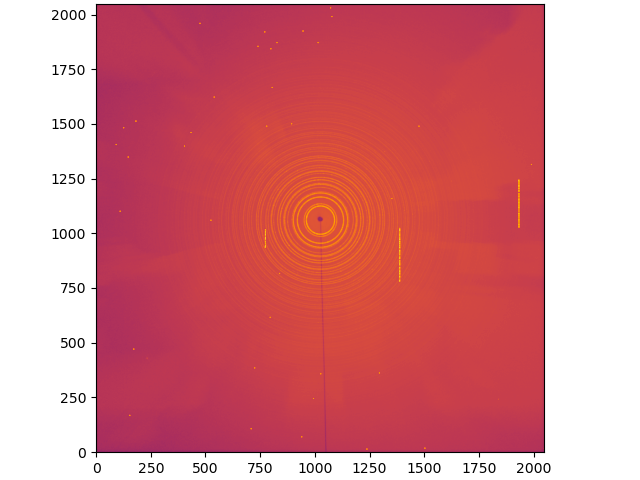

In [119]:
ds_set2_pdf_CeO2_left = ds_set2_pdf["pe1_imgs"].data[0,:,:]- ds_set2_pdf["pe1_img_dark"].data 
ax = jupyter.display(ds_set2_pdf_CeO2_left)

In [542]:
calibration_set2_pdf_CeO2_left = Calibration(ds_set2_pdf_CeO2_left,calibrant=CeO2,wavelength=wl,detector=PE1)

In [544]:
georef_set2_pdf_CeO2_left = calibration_set2_pdf_CeO2_left.geoRef
print(georef_set2_pdf_CeO2_left)
print(f"Fixed parameters: {calibration_set2_pdf_CeO2_left.fixed}")
print(f"Cost function: {georef_set2_pdf_CeO2_left.chi2()}")

Detector Perkin detector%s	 PixelSize= 200µm, 200µm
Wavelength= 1.806000e-11 m
SampleDetDist= 2.231895e-01 m	PONI= 2.122457e-01, 2.056946e-01 m	rot1=0.001983  rot2=-0.001044  rot3=0.000000 rad
DirectBeamDist= 223.190 mm	Center: x=1026.259, y=1060.064 pix	Tilt= 0.128° tiltPlanRotation= -152.242° 𝛌= 0.181Å
Fixed parameters: ['wavelength', 'rot3']
Cost function: 1.967271083686029e-06


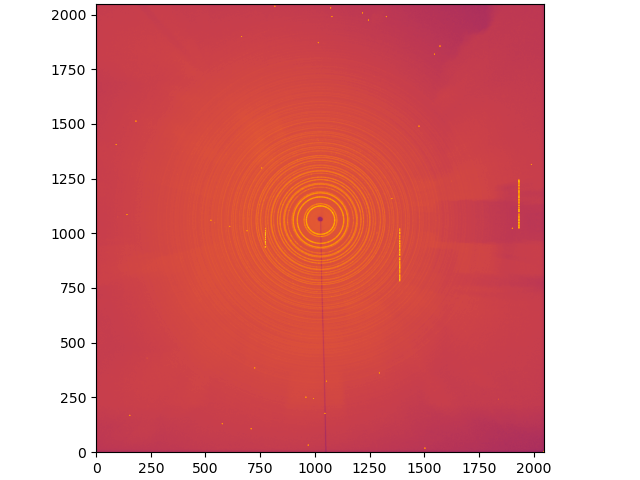

In [21]:
ds_set2_pdf_CeO2_right = ds_set2_pdf["pe1_imgs"].data[-1,:,:]- ds_set2_pdf["pe1_img_dark"].data 
ax = jupyter.display(ds_set2_pdf_CeO2_right)

In [27]:
calibration_set2_pdf_CeO2_right = Calibration(ds_set2_pdf_CeO2_right,calibrant=CeO2,wavelength=wl,detector=PE1)

In [29]:
georef_set2_pdf_CeO2_right = calibration_set2_pdf_CeO2_right.geoRef
print(georef_set2_pdf_CeO2_right)
print(f"Fixed parameters: {calibration_set2_pdf_CeO2_right.fixed}")
print(f"Cost function: {georef_set2_pdf_CeO2_right.chi2()}")

Detector Perkin detector%s	 PixelSize= 200µm, 200µm
Wavelength= 1.806000e-11 m
SampleDetDist= 2.242611e-01 m	PONI= 2.120177e-01, 2.050013e-01 m	rot1=-0.001184  rot2=-0.000075  rot3=0.000000 rad
DirectBeamDist= 224.261 mm	Center: x=1026.334, y=1060.004 pix	Tilt= 0.068° tiltPlanRotation= -3.633° 𝛌= 0.181Å
Fixed parameters: ['wavelength', 'rot3']
Cost function: 3.096835685098891e-06


 Left-side Direct Beam Distance = 223.190 mm, Right-side Direct Beam Distance = 224.261 mm; Average Direct Beam Distance = 223.726 mm

The sample holder was 1.071 mm out of square (0.48% variation), a shift of 120 um per sample

**OK to use CeO2-Left poni/edf for Set 1 PDF**

## Data Reduction

In [173]:
from copy import deepcopy

**SET 1 XRD**

In [232]:
dark_image = ds_set1_xrd.pe1_img_dark.astype('float32').values

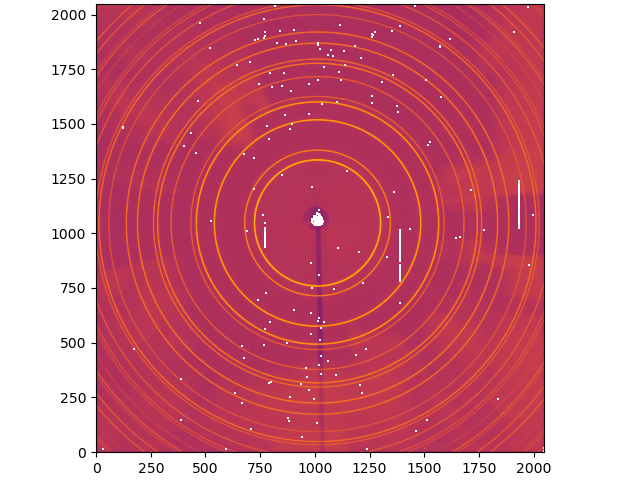

In [307]:
CeO2_left_image = ds_set1_xrd.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][0],df_set1_mBaseX['mBaseX / max'][0]))
CeO2_left_image = CeO2_left_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values
CeO2_left_image = CeO2_left_image - dark_image; CeO2_left_image[CeO2_left_image < 0] = np.nan
ax = jupyter.display(CeO2_left_image)

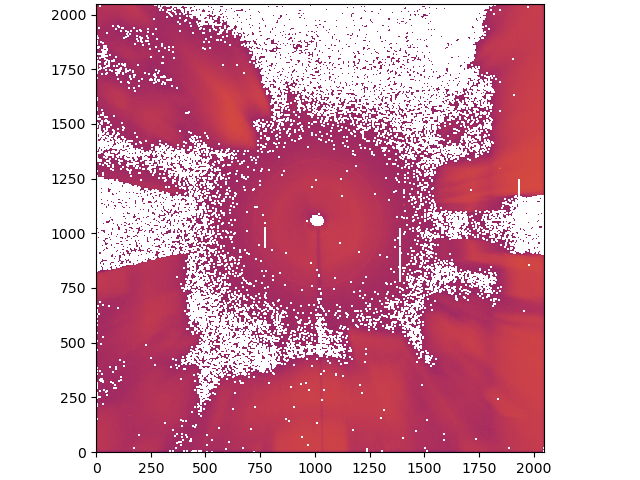

In [303]:
Kapton_image = ds_set1_xrd.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][1],df_set1_mBaseX['mBaseX / max'][1]))
Kapton_image = Kapton_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
Kapton_image = Kapton_image - dark_image; Kapton_image[Kapton_image < 0] = np.nan
ax = jupyter.display(Kapton_image)

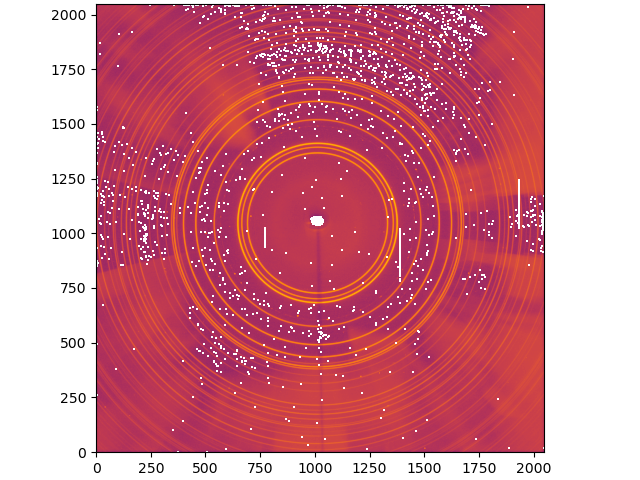

In [328]:
ZnO2_image = ds_set1_xrd.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][2],df_set1_mBaseX['mBaseX / max'][2]))
ZnO2_image = ZnO2_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
ZnO2_image = ZnO2_image - dark_image; ZnO2_image[ZnO2_image < 0] = np.nan
ax = jupyter.display(ZnO2_image)

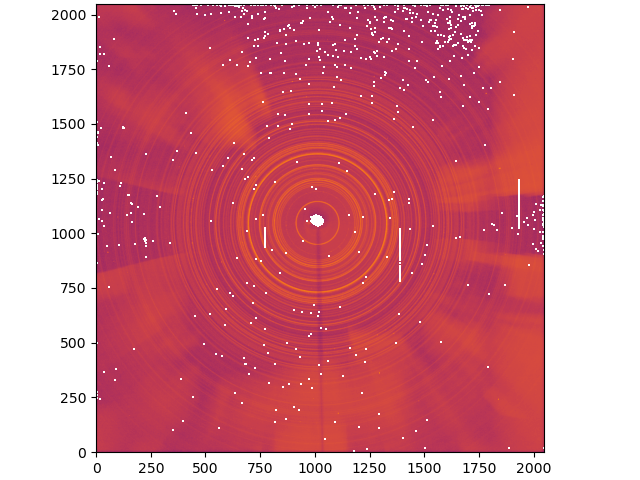

In [330]:
ZnO2_PO4_image = ds_set1_xrd.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][3],df_set1_mBaseX['mBaseX / max'][3]))
ZnO2_PO4_image = ZnO2_PO4_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
ZnO2_PO4_image = ZnO2_PO4_image - dark_image; ZnO2_PO4_image[ZnO2_PO4_image < 0] = np.nan
ax = jupyter.display(ZnO2_PO4_image)

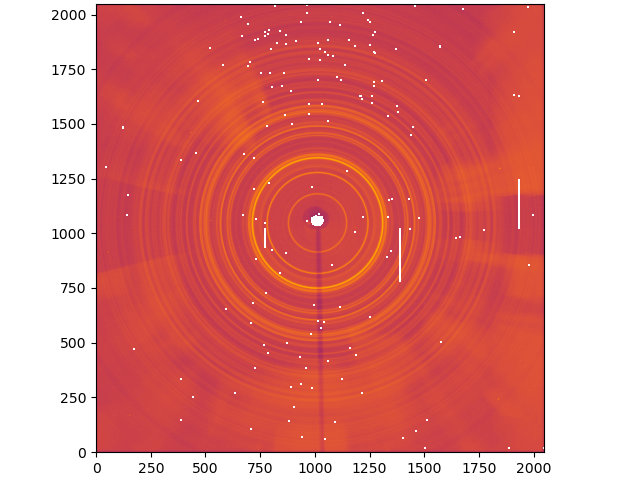

In [334]:
LaCO3_image = ds_set1_xrd.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][4],df_set1_mBaseX['mBaseX / max'][4]))
LaCO3_image = LaCO3_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
LaCO3_image = LaCO3_image - dark_image; LaCO3_image[LaCO3_image < 0] = np.nan
ax = jupyter.display(LaCO3_image)

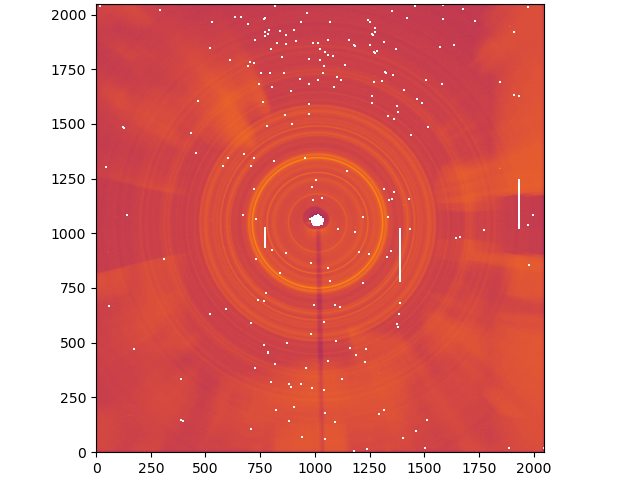

In [338]:
LaCO3_PO4_image = ds_set1_xrd.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][5],df_set1_mBaseX['mBaseX / max'][5]))
LaCO3_PO4_image = LaCO3_PO4_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
LaCO3_PO4_image = LaCO3_PO4_image - dark_image; LaCO3_PO4_image[LaCO3_PO4_image < 0] = np.nan
ax = jupyter.display(LaCO3_PO4_image)

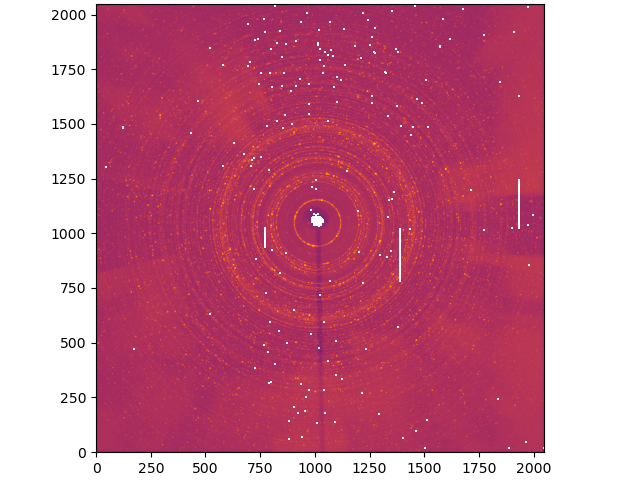

In [340]:
CeCO3_image = ds_set1_xrd.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][6],df_set1_mBaseX['mBaseX / max'][6]))
CeCO3_image = CeCO3_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
CeCO3_image = CeCO3_image - dark_image; CeCO3_image[CeCO3_image < 0] = np.nan
ax = jupyter.display(CeCO3_image)

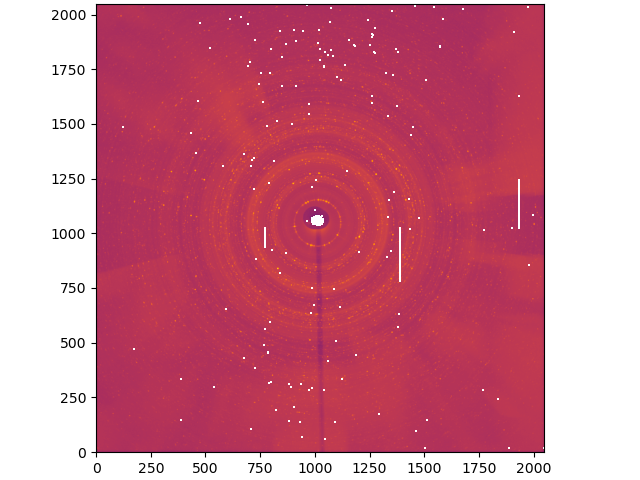

In [342]:
CeCO3_PO4_image = ds_set1_xrd.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][7],df_set1_mBaseX['mBaseX / max'][7]))
CeCO3_PO4_image = CeCO3_PO4_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
CeCO3_PO4_image = CeCO3_PO4_image - dark_image; CeCO3_PO4_image[CeCO3_PO4_image < 0] = np.nan
ax = jupyter.display(CeCO3_PO4_image)

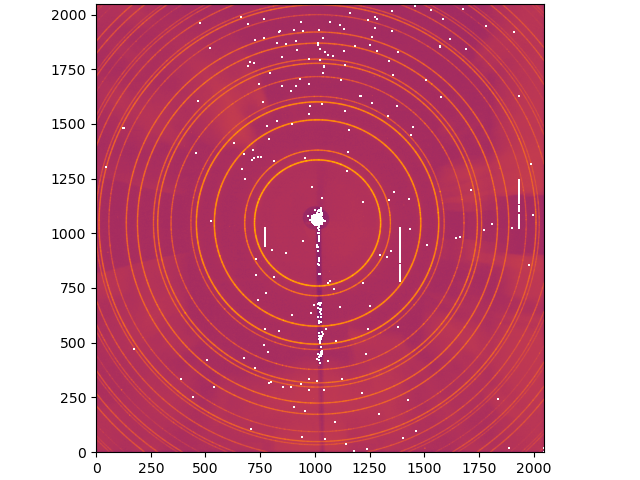

In [344]:
CeO2_right_image = ds_set1_xrd.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][8],df_set1_mBaseX['mBaseX / max'][8]))
CeO2_right_image = CeO2_right_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
CeO2_right_image = CeO2_right_image - dark_image; CeO2_right_image[CeO2_right_image < 0] = np.nan
ax = jupyter.display(CeO2_right_image)

In [372]:
Kapton_xrd = exrd()
Kapton_xrd.load_xrd_data(
    from_img_array=Kapton_image,
    ai = ai_Set1_XRD,
    mask = mask_XRD,
    radial_range = [0.5,9.5],
    plot = False
    )

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


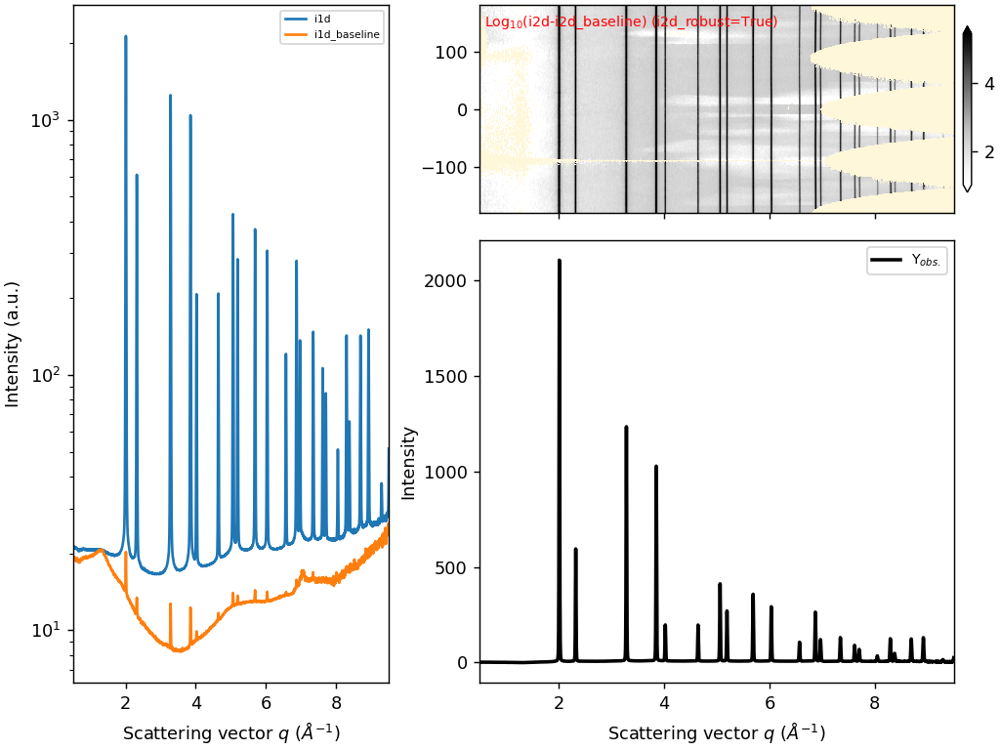

In [390]:
set1_ceo2_left_exrd = exrd(i1d_ylogscale=False)
set1_ceo2_left_exrd.load_xrd_data(
    from_img_array=CeO2_left_image,
    ai = ai_Set1_XRD,
    mask = mask_XRD,
    #median_filter_size=4,
    radial_range = [0.5,9.5],
    plot=False
    )
set1_ceo2_left_exrd.get_baseline(
    input_bkg = Kapton_xrd,
    use_iarpls = False,
    plot=True,)

CeO2_left_XRD = set1_ceo2_left_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


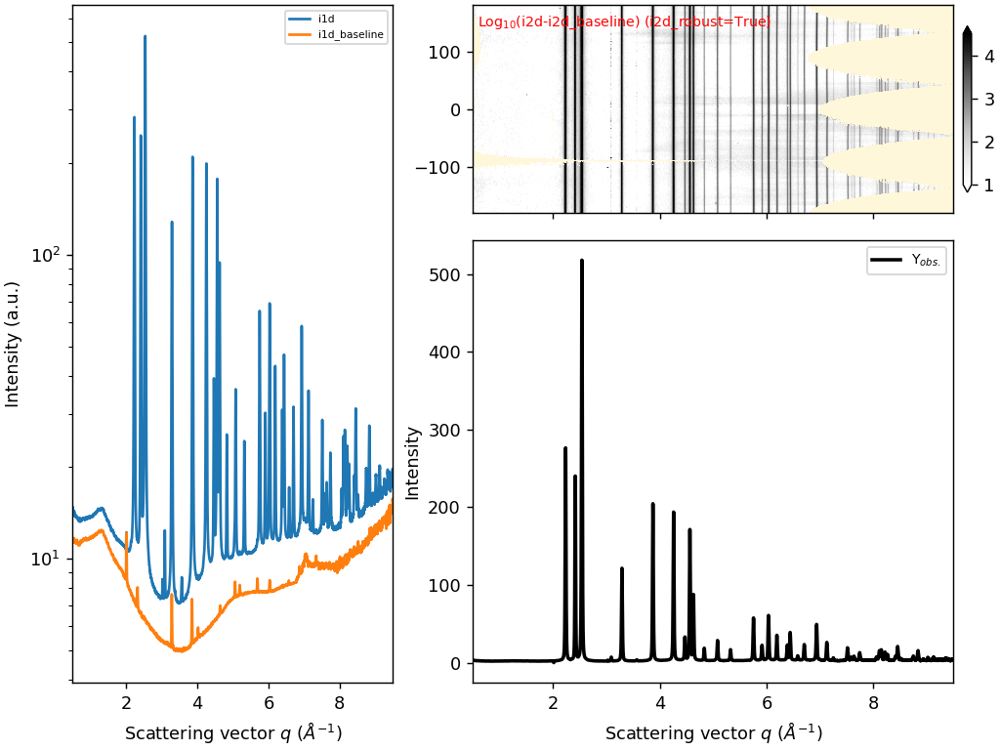

In [397]:
set1_zn02_exrd = exrd(i1d_ylogscale=False)
set1_zn02_exrd.load_xrd_data(
    from_img_array=ZnO2_image,
    ai = ai_Set1_XRD,
    mask = mask_XRD,
    #median_filter_size=4,
    radial_range = [0.5,9.5],
    plot=False
    )
set1_zn02_exrd.get_baseline(
    input_bkg = Kapton_xrd,
    use_iarpls = False,
    plot=True,)

ZnO2_XRD = set1_zn02_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


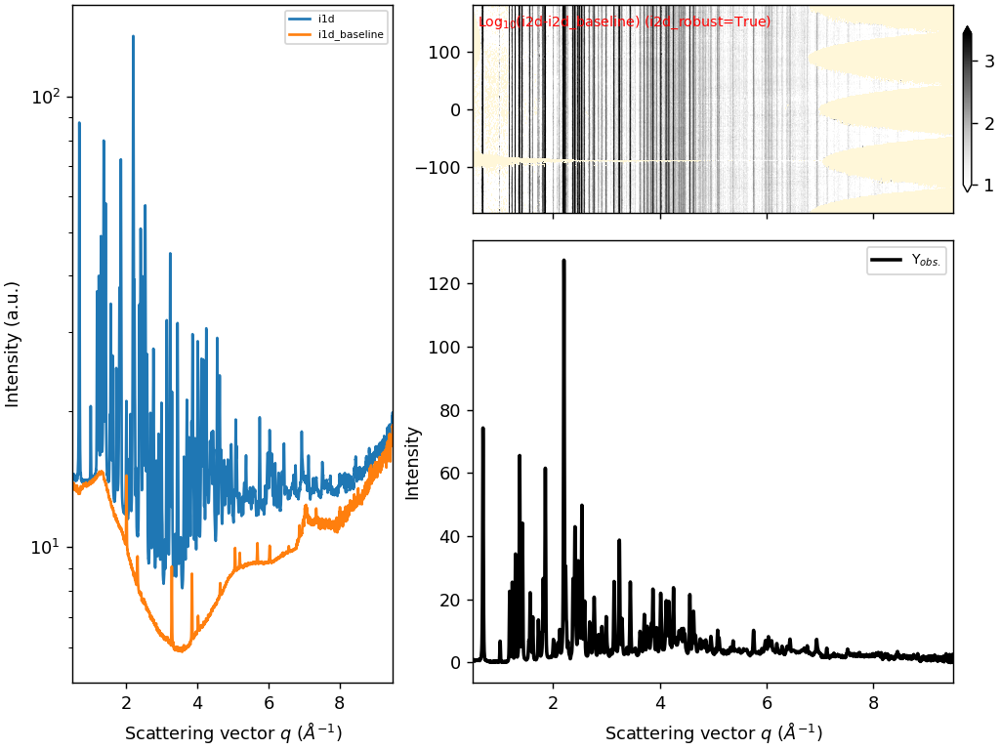

In [399]:
set1_zno2_po4_exrd = exrd(i1d_ylogscale=False)
set1_zno2_po4_exrd.load_xrd_data(
    from_img_array=ZnO2_PO4_image,
    ai = ai_Set1_XRD,
    mask = mask_XRD,
    #median_filter_size=4,
    radial_range = [0.5,9.5],
    plot=False
    )
set1_zno2_po4_exrd.get_baseline(
    input_bkg = Kapton_xrd,
    use_iarpls = False,
    plot=True,)

ZnO2_PO4_XRD = set1_zno2_po4_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


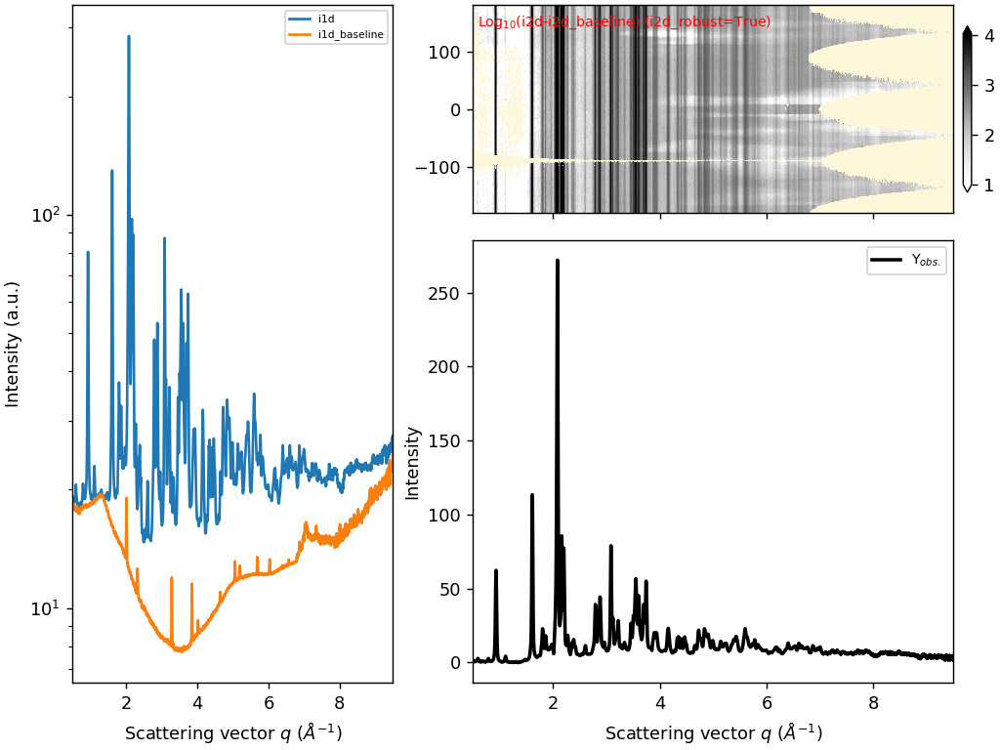

In [401]:
set1_laco2_exrd = exrd(i1d_ylogscale=False)
set1_laco2_exrd.load_xrd_data(
    from_img_array=LaCO3_image,
    ai = ai_Set1_XRD,
    mask = mask_XRD,
    #median_filter_size=4,
    radial_range = [0.5,9.5],
    plot=False
    )
set1_laco2_exrd.get_baseline(
    input_bkg = Kapton_xrd,
    use_iarpls = False,
    plot=True,)

LaCO3_XRD = set1_laco2_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


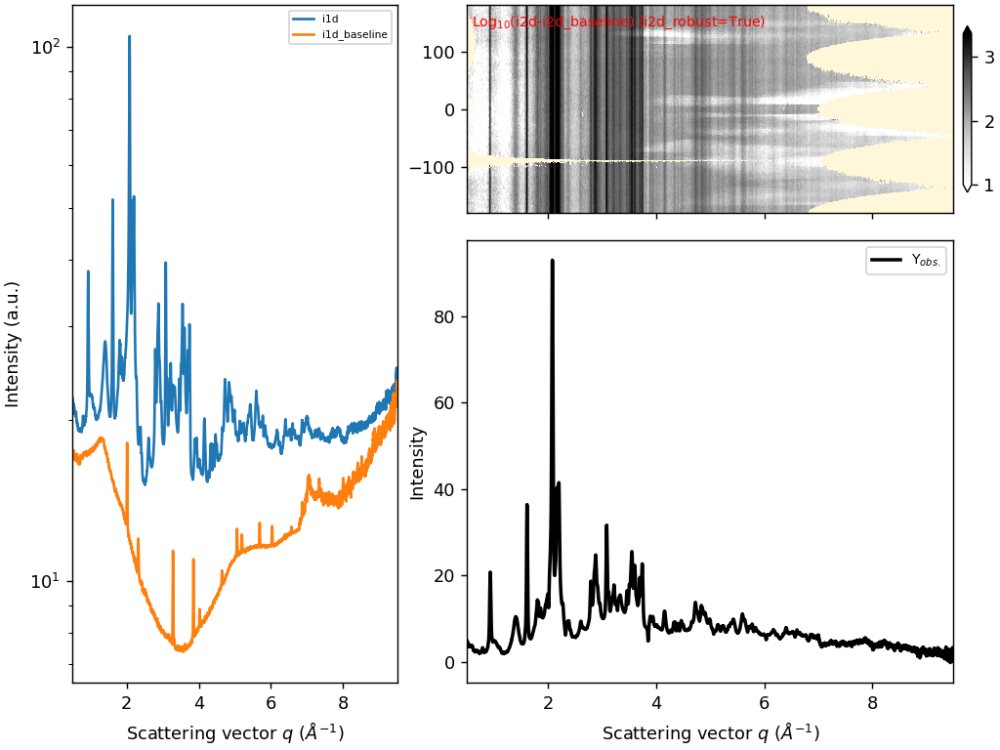

In [403]:
set1_laco3_po4_exrd = exrd(i1d_ylogscale=False)
set1_laco3_po4_exrd.load_xrd_data(
    from_img_array=LaCO3_PO4_image,
    ai = ai_Set1_XRD,
    mask = mask_XRD,
    #median_filter_size=4,
    radial_range = [0.5,9.5],
    plot=False
    )
set1_laco3_po4_exrd.get_baseline(
    input_bkg = Kapton_xrd,
    use_iarpls = False,
    plot=True,)

LaCO3_PO4_XRD = set1_laco3_po4_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


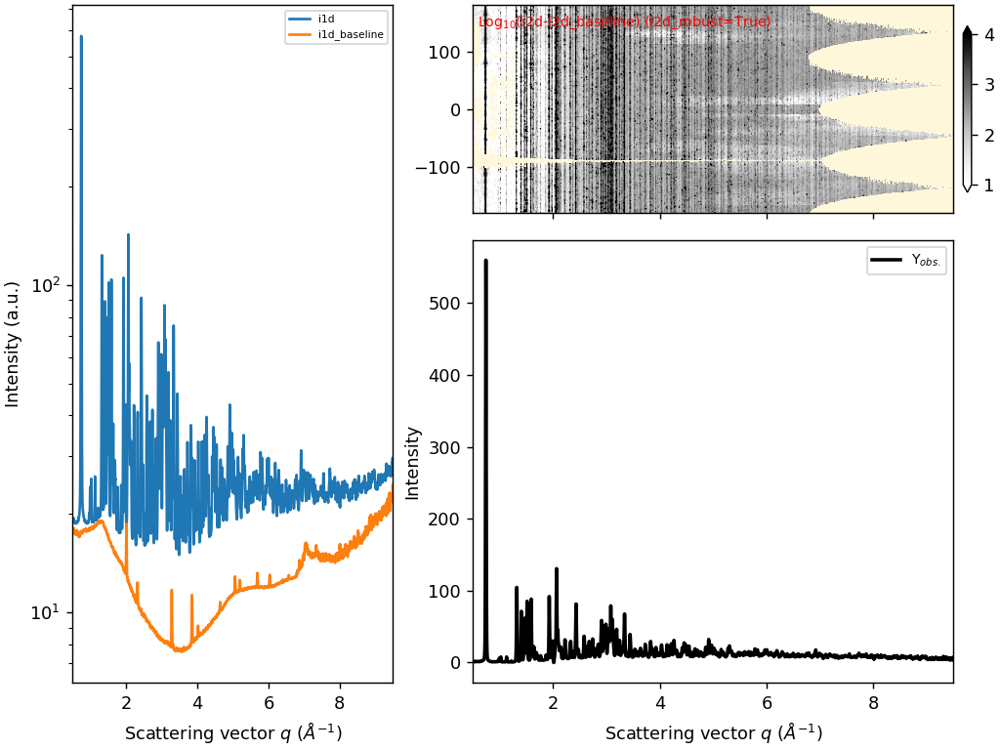

In [405]:
set1_ceco3_exrd = exrd(i1d_ylogscale=False)
set1_ceco3_exrd.load_xrd_data(
    from_img_array=CeCO3_image,
    ai = ai_Set1_XRD,
    mask = mask_XRD,
    #median_filter_size=4,
    radial_range = [0.5,9.5],
    plot=False
    )
set1_ceco3_exrd.get_baseline(
    input_bkg = Kapton_xrd,
    use_iarpls = False,
    plot=True,)

CeCO3_XRD = set1_ceco3_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


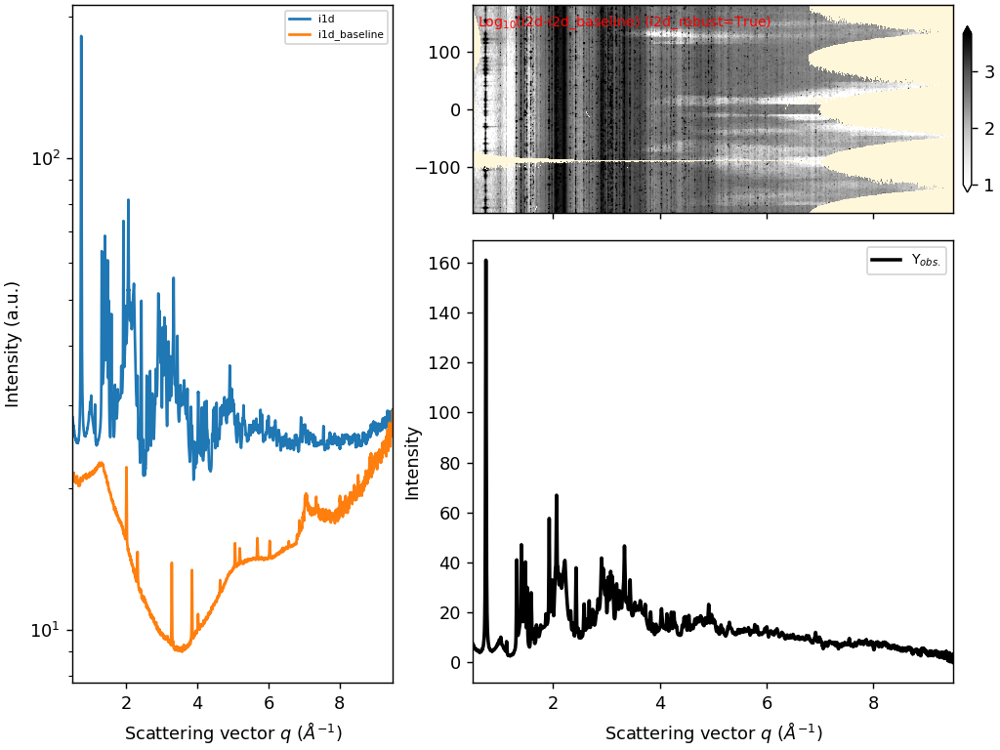

In [407]:
set1_ceco3_po4_exrd = exrd(i1d_ylogscale=False)
set1_ceco3_po4_exrd.load_xrd_data(
    from_img_array=CeCO3_PO4_image,
    ai = ai_Set1_XRD,
    mask = mask_XRD,
    #median_filter_size=4,
    radial_range = [0.5,9.5],
    plot=False
    )
set1_ceco3_po4_exrd.get_baseline(
    input_bkg = Kapton_xrd,
    use_iarpls = False,
    plot=True,)

CeCO3_PO4_XRD = set1_ceco3_po4_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


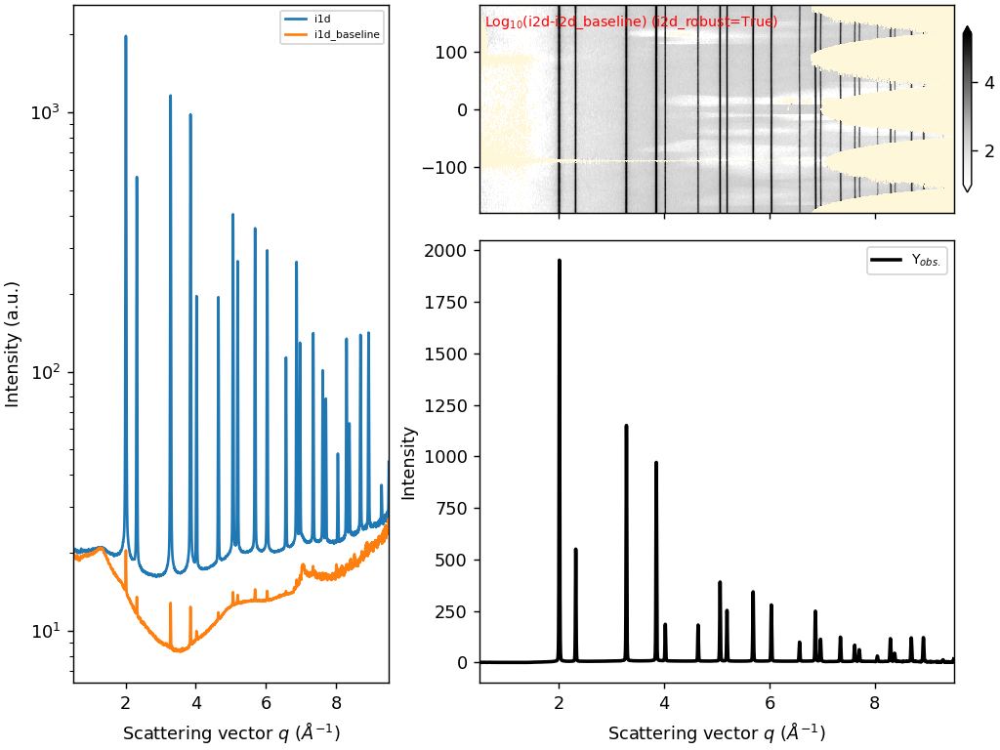

In [409]:
set1_ceo2_right_exrd = exrd(i1d_ylogscale=False)
set1_ceo2_right_exrd.load_xrd_data(
    from_img_array=CeO2_right_image,
    ai = ai_Set1_XRD,
    mask = mask_XRD,
    #median_filter_size=4,
    radial_range = [0.5,9.5],
    plot=False
    )
set1_ceo2_right_exrd.get_baseline(
    input_bkg = Kapton_xrd,
    use_iarpls = False,
    plot=True,)

CeO2_right_XRD = set1_ceo2_right_exrd

In [102]:
def export_i1d_as_xy(exrd_object, export_as,subtract_baseline=True):
    data_x = np.rad2deg(2*np.arcsin(exrd_object.ds.i1d.radial*((exrd_object.ds.i1d.attrs["wavelength_in_angst"])/(4*np.pi))))

    if subtract_baseline:
        out = np.column_stack (( data_x,  (exrd_object.ds.i1d-exrd_object.ds.i1d_baseline).values ))
    else:
        out = np.column_stack (( data_x,  exrd_object.ds.i1d.values ))
 
    np.savetxt(export_as,out)

In [416]:
SET_1 = [CeO2_left_XRD, ZnO2_XRD, ZnO2_PO4_XRD, LaCO3_XRD, LaCO3_PO4_XRD,CeCO3_XRD, CeCO3_PO4_XRD,CeO2_right_XRD]
set_one = ['CeO2_left_XRD', 'ZnO2_XRD', 'ZnO2_PO4_XRD', 'LaCO3_XRD', 'LaCO3_PO4_XRD','CeCO3_XRD', 'CeCO3_PO4_XRD','CeO2_right_XRD']
for i,j in zip(SET_1,set_one):
    export_i1d_as_xy(i,path_to_out+j+'.xy')

**SET 1 PDF**

In [441]:
dark_image = ds_set1_pdf.pe1_img_dark.astype('float32').values

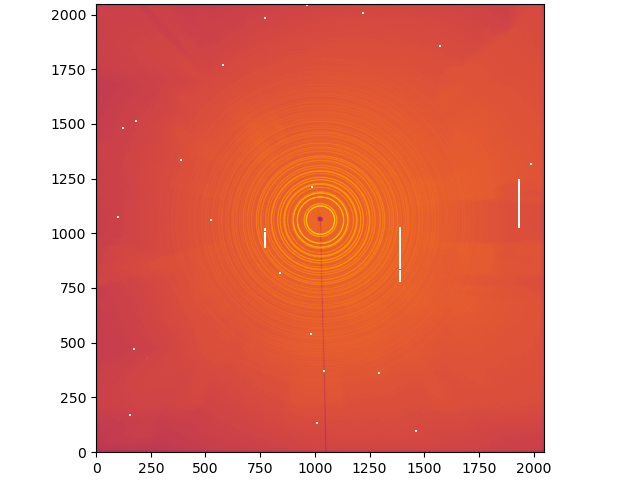

In [443]:
CeO2_left_image = ds_set1_pdf.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][0],df_set1_mBaseX['mBaseX / max'][0]))
CeO2_left_image = CeO2_left_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values
CeO2_left_image = CeO2_left_image - dark_image; CeO2_left_image[CeO2_left_image < 0] = np.nan
ax = jupyter.display(CeO2_left_image)

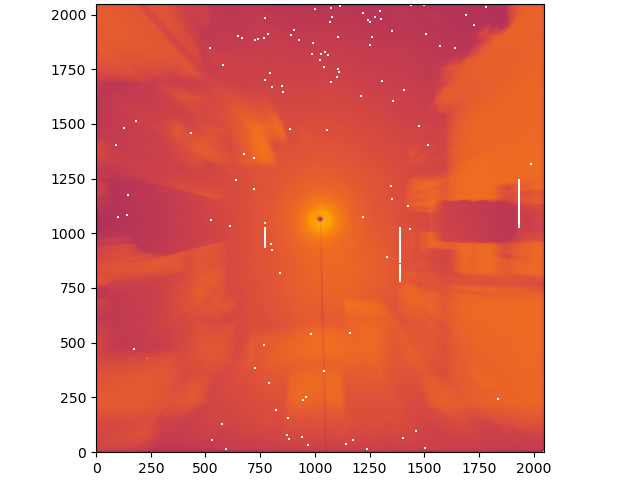

In [445]:
Kapton_image = ds_set1_pdf.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][1],df_set1_mBaseX['mBaseX / max'][1]))
Kapton_image = Kapton_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
Kapton_image = Kapton_image - dark_image; Kapton_image[Kapton_image < 0] = np.nan
ax = jupyter.display(Kapton_image)

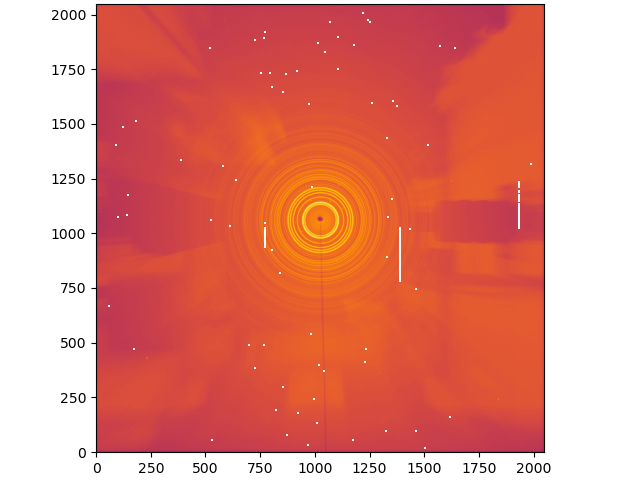

In [447]:
ZnO2_image = ds_set1_pdf.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][2],df_set1_mBaseX['mBaseX / max'][2]))
ZnO2_image = ZnO2_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
ZnO2_image = ZnO2_image - dark_image; ZnO2_image[ZnO2_image < 0] = np.nan
ax = jupyter.display(ZnO2_image)

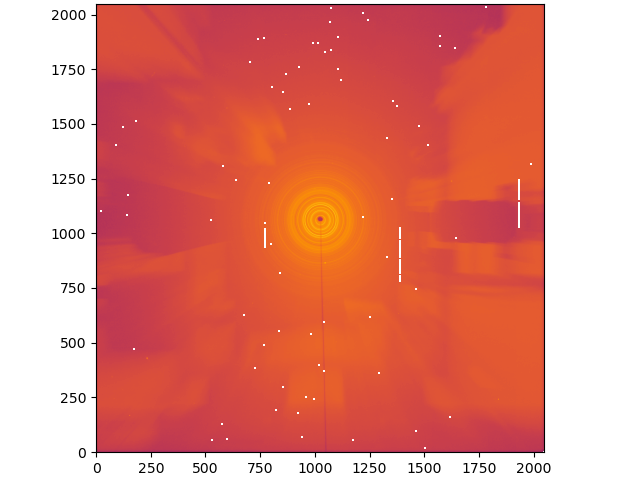

In [449]:
ZnO2_PO4_image = ds_set1_pdf.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][3],df_set1_mBaseX['mBaseX / max'][3]))
ZnO2_PO4_image = ZnO2_PO4_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
ZnO2_PO4_image = ZnO2_PO4_image - dark_image; ZnO2_PO4_image[ZnO2_PO4_image < 0] = np.nan
ax = jupyter.display(ZnO2_PO4_image)

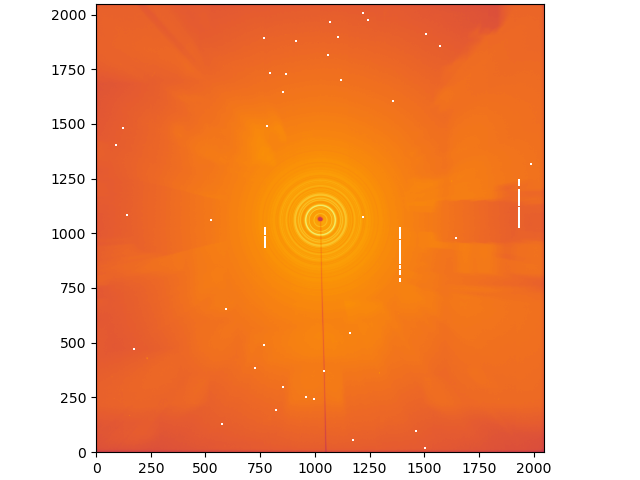

In [451]:
LaCO3_image = ds_set1_pdf.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][4],df_set1_mBaseX['mBaseX / max'][4]))
LaCO3_image = LaCO3_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
LaCO3_image = LaCO3_image - dark_image; LaCO3_image[LaCO3_image < 0] = np.nan
ax = jupyter.display(LaCO3_image)

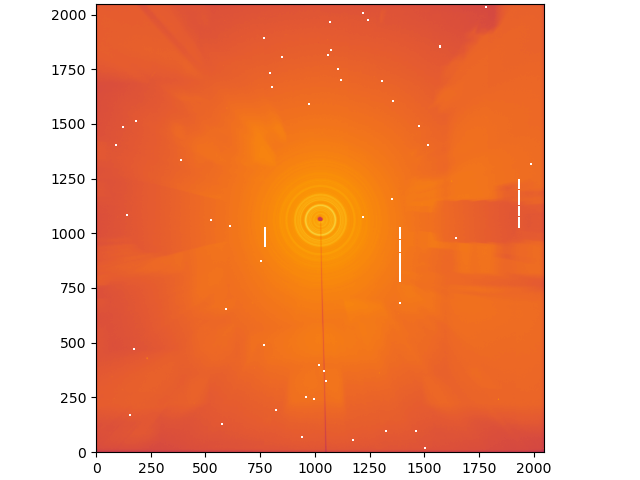

In [453]:
LaCO3_PO4_image = ds_set1_pdf.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][5],df_set1_mBaseX['mBaseX / max'][5]))
LaCO3_PO4_image = LaCO3_PO4_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
LaCO3_PO4_image = LaCO3_PO4_image - dark_image; LaCO3_PO4_image[LaCO3_PO4_image < 0] = np.nan
ax = jupyter.display(LaCO3_PO4_image)

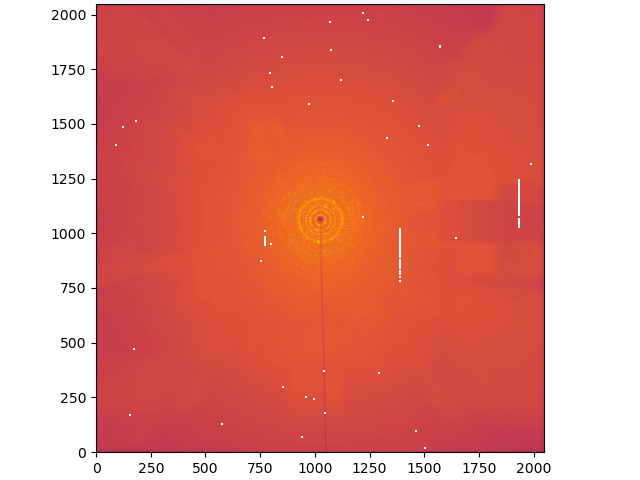

In [455]:
CeCO3_image = ds_set1_pdf.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][6],df_set1_mBaseX['mBaseX / max'][6]))
CeCO3_image = CeCO3_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
CeCO3_image = CeCO3_image - dark_image; CeCO3_image[CeCO3_image < 0] = np.nan
ax = jupyter.display(CeCO3_image)

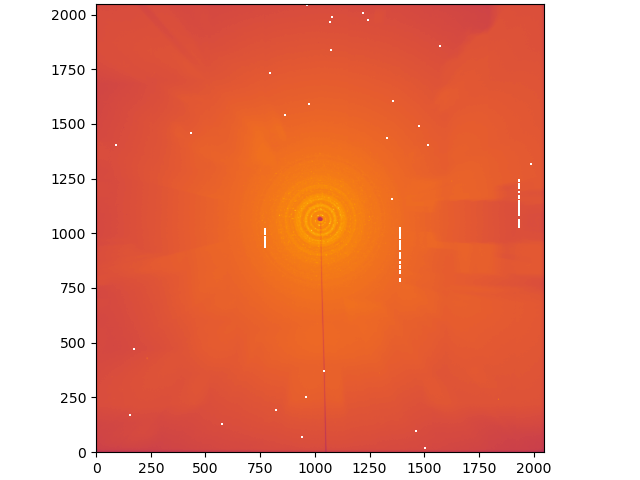

In [457]:
CeCO3_PO4_image = ds_set1_pdf.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][7],df_set1_mBaseX['mBaseX / max'][7]))
CeCO3_PO4_image = CeCO3_PO4_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
CeCO3_PO4_image = CeCO3_PO4_image - dark_image; CeCO3_PO4_image[CeCO3_PO4_image < 0] = np.nan
ax = jupyter.display(CeCO3_PO4_image)

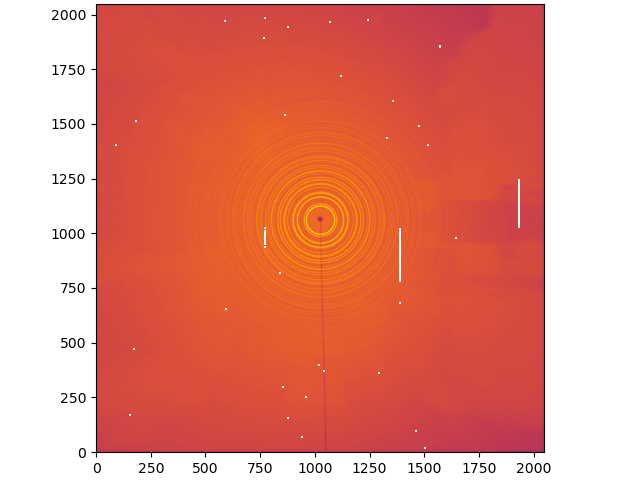

In [459]:
CeO2_right_image = ds_set1_pdf.sel(mBaseX=slice(df_set1_mBaseX['mBaseX / min'][8],df_set1_mBaseX['mBaseX / max'][8]))
CeO2_right_image = CeO2_right_image.pe1_imgs.mean(dim=['mBaseX']).astype('float32').values 
CeO2_right_image = CeO2_right_image - dark_image; CeO2_right_image[CeO2_right_image < 0] = np.nan
ax = jupyter.display(CeO2_right_image)

In [469]:
Kapton_pdf = exrd()
Kapton_pdf.load_xrd_data(
    from_img_array=Kapton_image,
    ai = ai_Set1_PDF,
    mask = mask_PDF,
    radial_range = [0.5,29.5],
    plot = False
    )

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


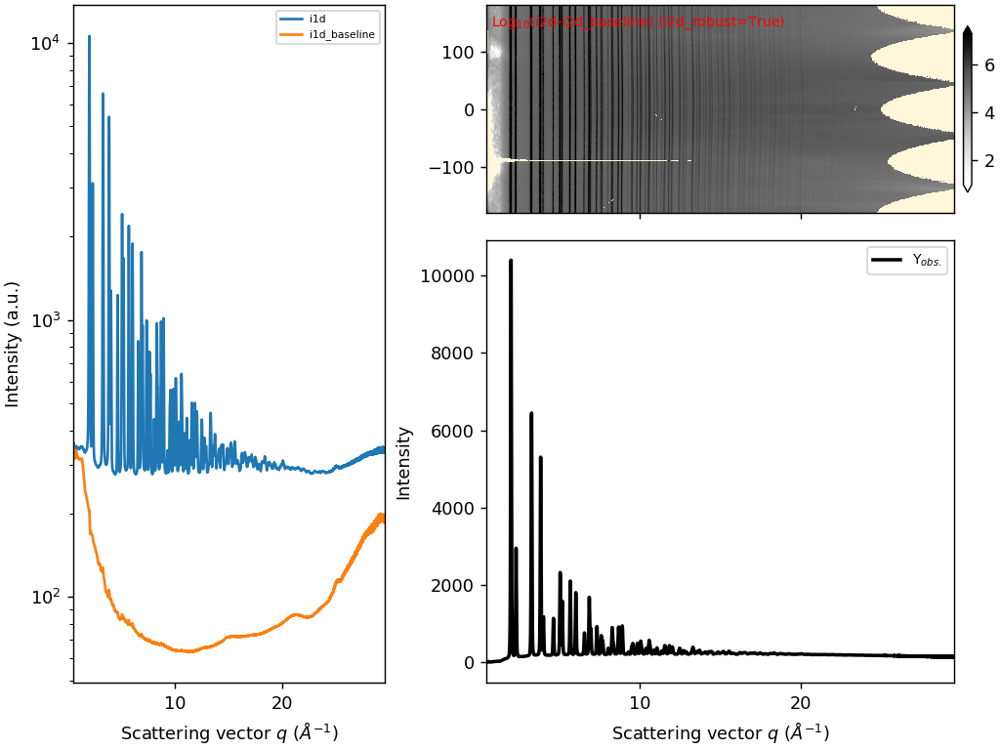

In [471]:
set1_ceo2_left_exrd = exrd(i1d_ylogscale=False)
set1_ceo2_left_exrd.load_xrd_data(
    from_img_array=CeO2_left_image,
    ai = ai_Set1_PDF,
    mask = mask_PDF,
    #median_filter_size=4,
    radial_range = [0.5,29.5],
    plot=False
    )
set1_ceo2_left_exrd.get_baseline(
    input_bkg = Kapton_pdf,
    use_iarpls = False,
    plot=True,)

CeO2_left_PDF = set1_ceo2_left_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


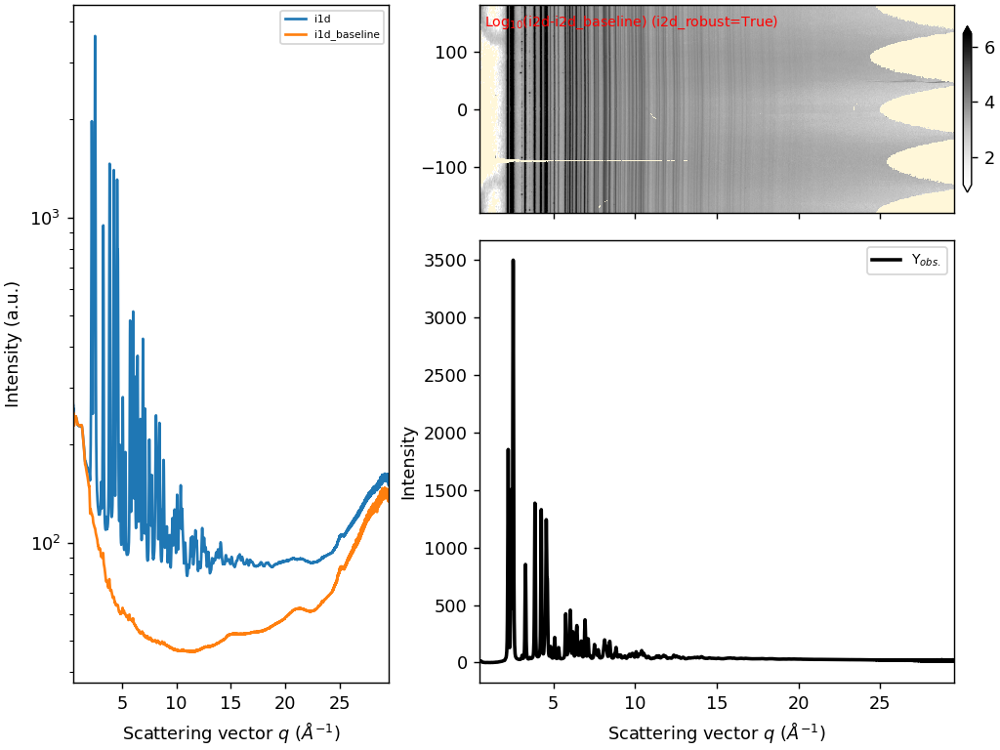

In [473]:
set1_zn02_exrd = exrd(i1d_ylogscale=False)
set1_zn02_exrd.load_xrd_data(
    from_img_array=ZnO2_image,
    ai = ai_Set1_PDF,
    mask = mask_PDF,
    #median_filter_size=4,
    radial_range = [0.5,29.5],
    plot=False
    )
set1_zn02_exrd.get_baseline(
    input_bkg = Kapton_pdf,
    use_iarpls = False,
    plot=True,)

ZnO2_PDF = set1_zn02_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


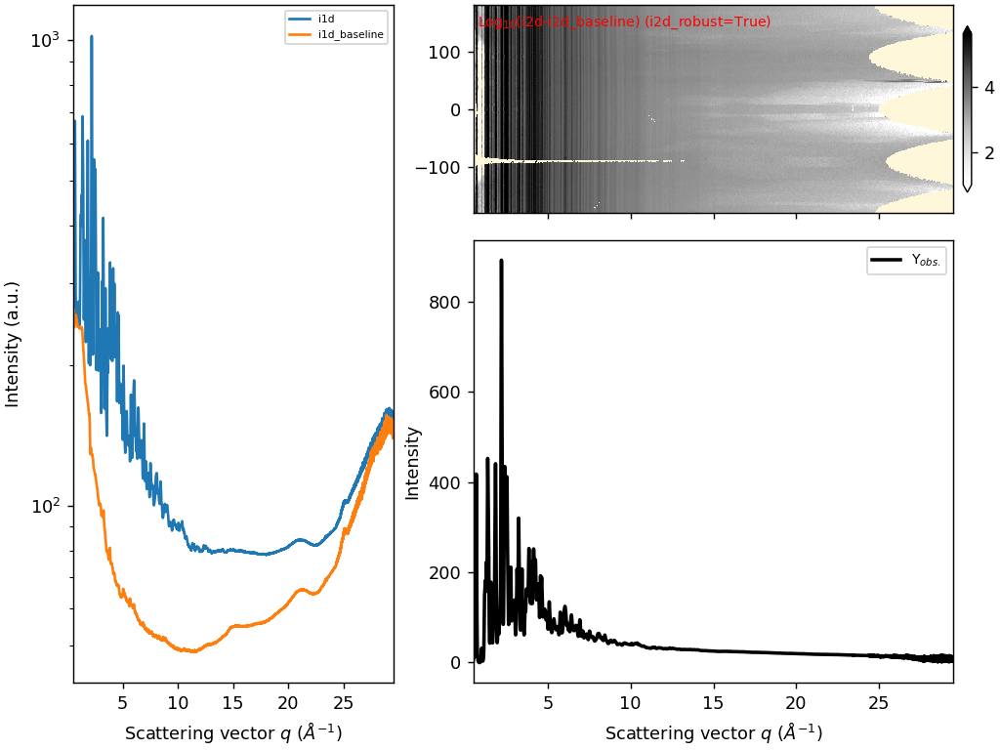

In [475]:
set1_zno2_po4_exrd = exrd(i1d_ylogscale=False)
set1_zno2_po4_exrd.load_xrd_data(
    from_img_array=ZnO2_PO4_image,
    ai = ai_Set1_PDF,
    mask = mask_PDF,
    #median_filter_size=4,
    radial_range = [0.5,29.5],
    plot=False
    )
set1_zno2_po4_exrd.get_baseline(
    input_bkg = Kapton_pdf,
    use_iarpls = False,
    plot=True,)

ZnO2_PO4_PDF = set1_zno2_po4_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


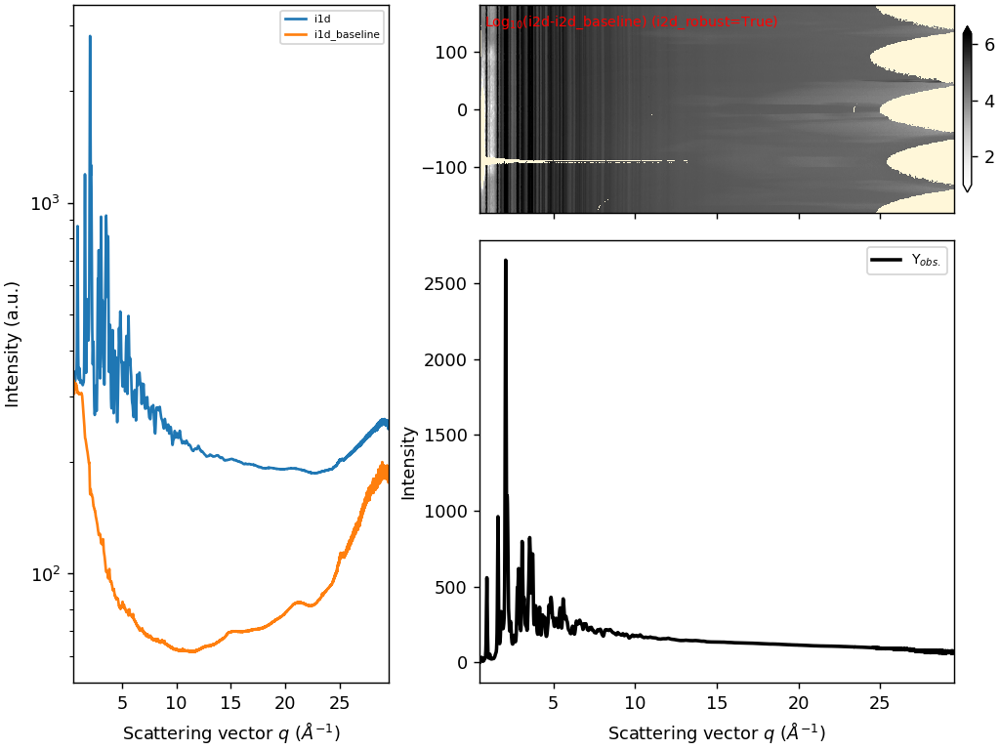

In [477]:
set1_laco2_exrd = exrd(i1d_ylogscale=False)
set1_laco2_exrd.load_xrd_data(
    from_img_array=LaCO3_image,
    ai = ai_Set1_PDF,
    mask = mask_PDF,
    #median_filter_size=4,
    radial_range = [0.5,29.5],
    plot=False
    )
set1_laco2_exrd.get_baseline(
    input_bkg = Kapton_pdf,
    use_iarpls = False,
    plot=True,)

LaCO3_PDF = set1_laco2_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


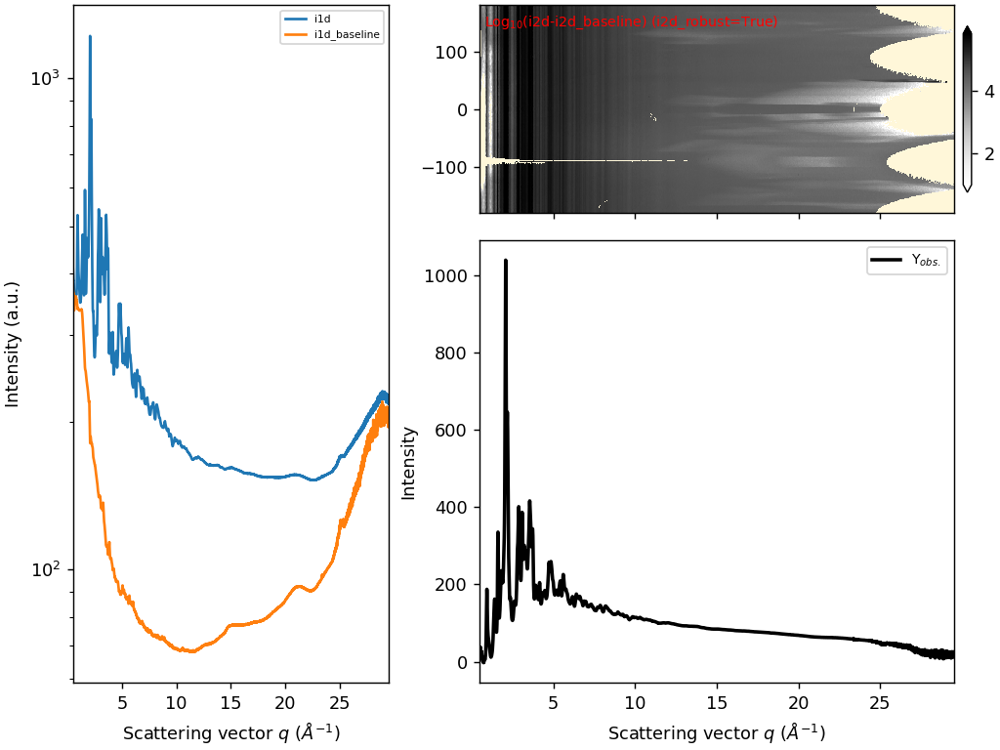

In [479]:
set1_laco3_po4_exrd = exrd(i1d_ylogscale=False)
set1_laco3_po4_exrd.load_xrd_data(
    from_img_array=LaCO3_PO4_image,
    ai = ai_Set1_PDF,
    mask = mask_PDF,
    #median_filter_size=4,
    radial_range = [0.5,29.5],
    plot=False
    )
set1_laco3_po4_exrd.get_baseline(
    input_bkg = Kapton_pdf,
    use_iarpls = False,
    plot=True,)

LaCO3_PO4_PDF = set1_laco3_po4_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


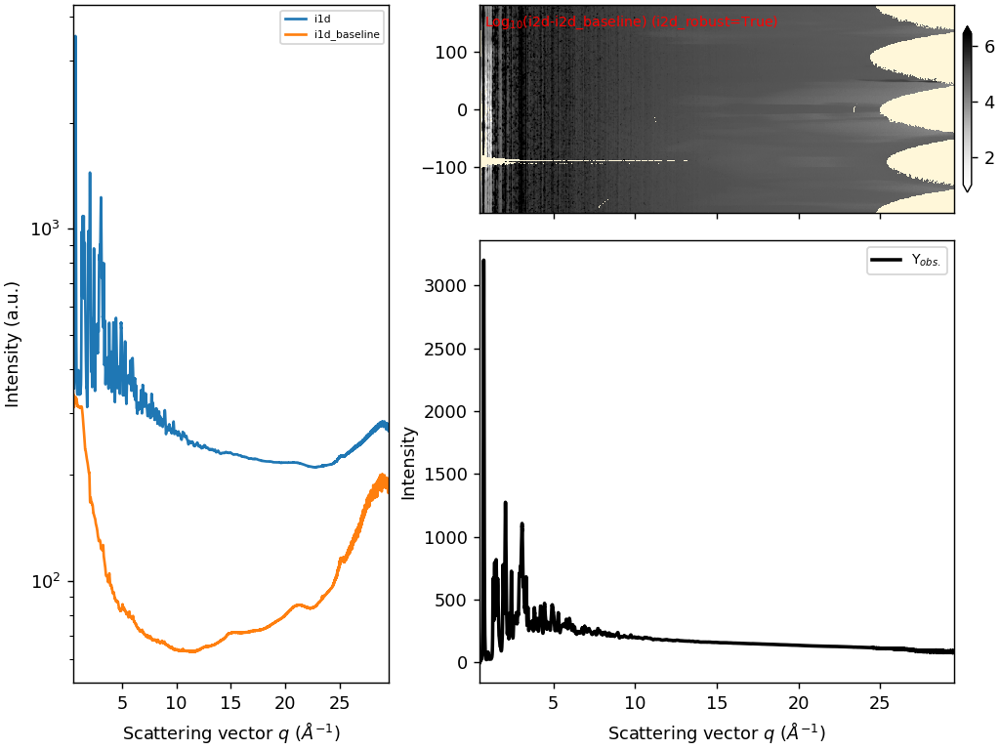

In [481]:
set1_ceco3_exrd = exrd(i1d_ylogscale=False)
set1_ceco3_exrd.load_xrd_data(
    from_img_array=CeCO3_image,
    ai = ai_Set1_PDF,
    mask = mask_PDF,
    #median_filter_size=4,
    radial_range = [0.5,29.5],
    plot=False
    )
set1_ceco3_exrd.get_baseline(
    input_bkg = Kapton_pdf,
    use_iarpls = False,
    plot=True,)

CeCO3_PDF = set1_ceco3_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


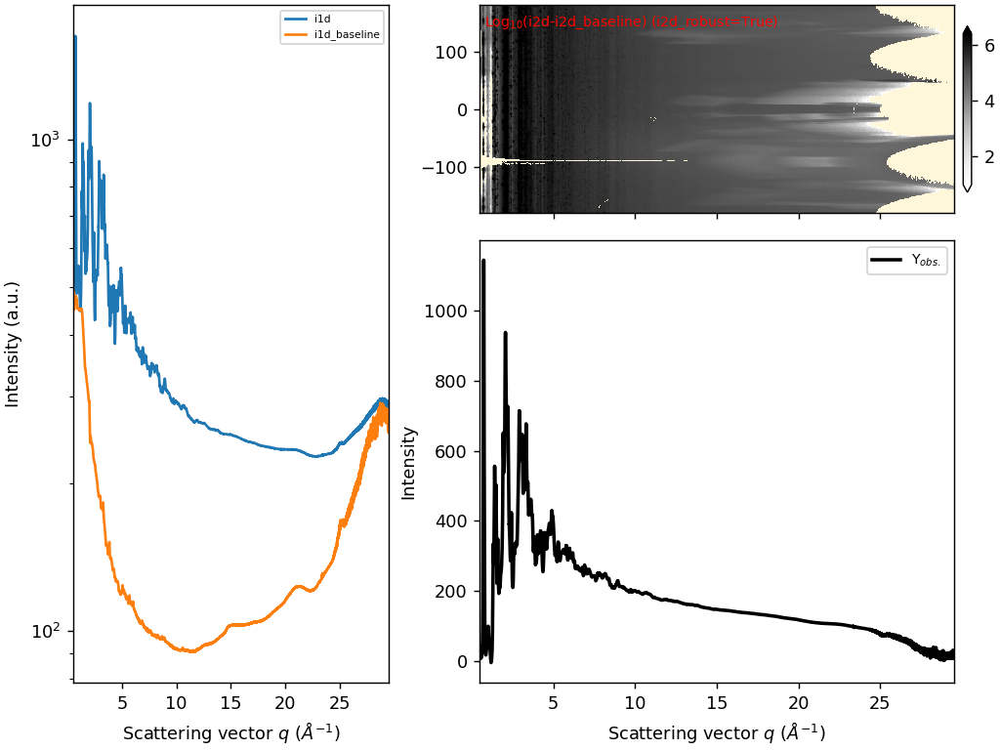

In [483]:
set1_ceco3_po4_exrd = exrd(i1d_ylogscale=False)
set1_ceco3_po4_exrd.load_xrd_data(
    from_img_array=CeCO3_PO4_image,
    ai = ai_Set1_PDF,
    mask = mask_PDF,
    #median_filter_size=4,
    radial_range = [0.5,29.5],
    plot=False
    )
set1_ceco3_po4_exrd.get_baseline(
    input_bkg = Kapton_pdf,
    use_iarpls = False,
    plot=True,)

CeCO3_PO4_PDF = set1_ceco3_po4_exrd

'NoneType' object is not iterable
Unable to include ds_attrs in self.ds


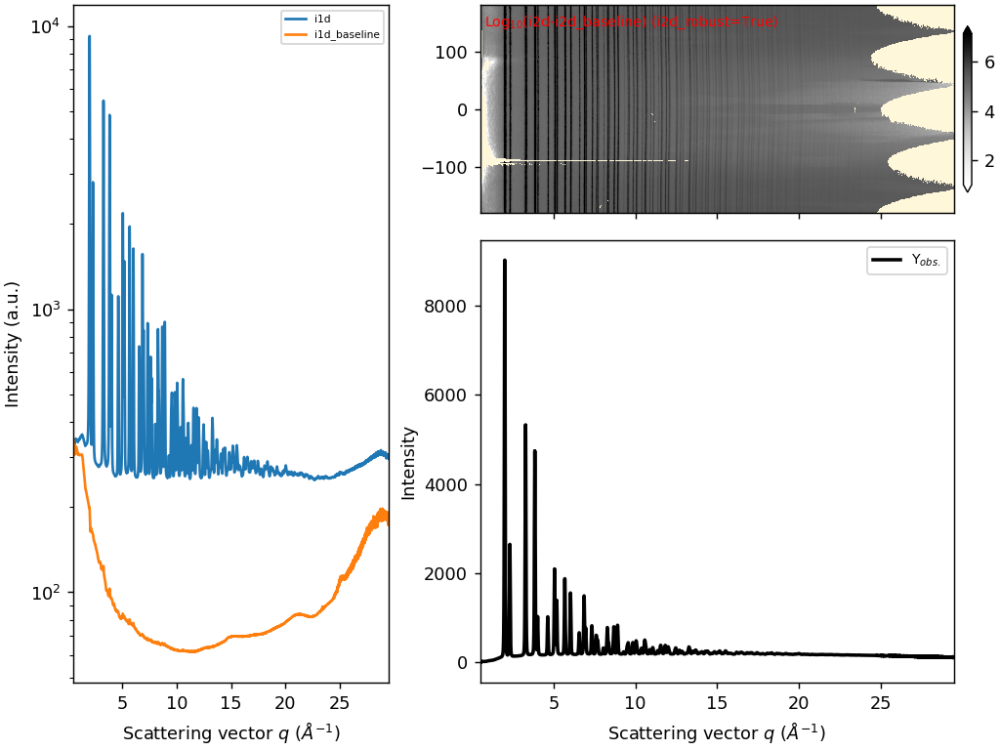

In [485]:
set1_ceo2_right_exrd = exrd(i1d_ylogscale=False)
set1_ceo2_right_exrd.load_xrd_data(
    from_img_array=CeO2_right_image,
    ai = ai_Set1_PDF,
    mask = mask_PDF,
    #median_filter_size=4,
    radial_range = [0.5,29.5],
    plot=False
    )
set1_ceo2_right_exrd.get_baseline(
    input_bkg = Kapton_pdf,
    use_iarpls = False,
    plot=True,)

CeO2_right_PDF = set1_ceo2_right_exrd

In [487]:
SET_1 = [CeO2_left_PDF, ZnO2_PDF, ZnO2_PO4_PDF, LaCO3_PDF, LaCO3_PO4_PDF,CeCO3_PDF, CeCO3_PO4_PDF,CeO2_right_PDF]
set_one = ['CeO2_left_PDF', 'ZnO2_PDF', 'ZnO2_PO4_PDF', 'LaCO3_PDF', 'LaCO3_PO4_PDF','CeCO3_PDF', 'CeCO3_PO4_PDF','CeO2_right_PDF']
for i,j in zip(SET_1,set_one):
    export_i1d_as_xy(i,path_to_out+j+'.xy')